I want to create a for loop code that generates cloropleth maps of the L Line stations in our study. But first, I need to know which census tracts falls within the walkshed. This requires taking a step back and first generating walkshed maps to identify which census tracts land within our walkshed. 

In [2]:
# Let's start by importing all of the libraries we'll need for our analyses

import pandas as pd

import geopandas as gpd

import contextily as ctx

import matplotlib.pyplot as plt

# for interactive plots
import plotly.express as px

# for network analysis
import networkx as nx

# for street network analysis
import osmnx as ox

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


### East LA Civic Center

Bringing in the address and establishing the time criteria for the walkshed. 

In [5]:
# Let's start by orienting ourselves around the East LA Civic Center Station by calling for it by address in osmnx

address = 'East Los Angeles Civic Center, East 3rd Street, Belvedere Gardens, East Los Angeles, Los Angeles County, California, 90022-1601, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [6]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.59 s, sys: 58.2 ms, total: 2.65 s
Wall time: 12.7 s


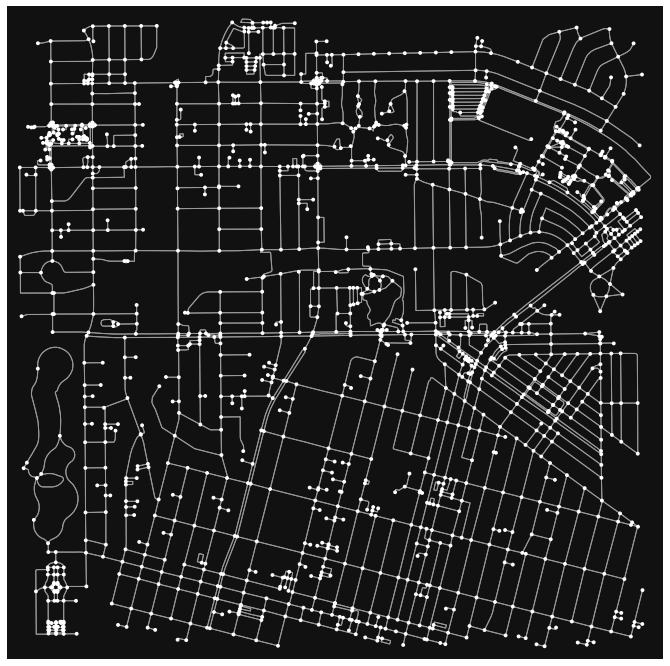

In [7]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [8]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [9]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [10]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
17445327,4.033839e+06,-1.315200e+07,traffic_signals,4,-118.146421,34.037501,POINT (-13151999.403 4033838.580)
8414804812,4.033816e+06,-1.315203e+07,NaN,3,-118.146684,34.037336,POINT (-13152028.735 4033816.401)
8414804800,4.033858e+06,-1.315197e+07,NaN,3,-118.146197,34.037648,POINT (-13151974.467 4033858.327)
3643016816,4.033796e+06,-1.315196e+07,NaN,4,-118.146107,34.037181,POINT (-13151964.459 4033795.566)
8414804799,4.033863e+06,-1.315202e+07,NaN,3,-118.146602,34.037683,POINT (-13152019.540 4033863.055)


<AxesSubplot:>

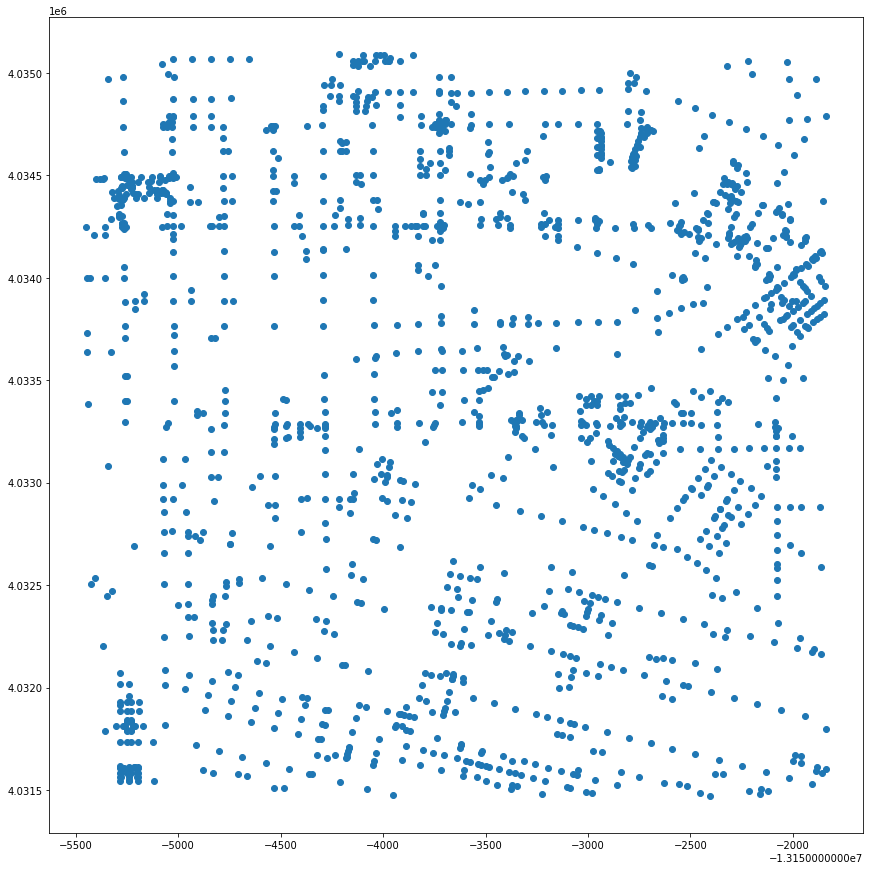

In [11]:
gdf_nodes.plot(figsize=(15,15))

In [12]:
gdf_edges.head()

osmid lanes                  name    highway  \
u          v          key                                                     
17445327   8414804812 0    397475166     7    Atlantic Boulevard    primary   
           8414804800 0    397479970     7    Atlantic Boulevard    primary   
           3643016816 0    397516716     5    West Reggin Street  secondary   
           8414804799 0    397516718     5  Avenida Cesar Chavez  secondary   
8414804812 4872874510 0    397475166     7    Atlantic Boulevard    primary   

                          maxspeed  oneway  length  \
u          v          key                            
17445327   8414804812 0     35 mph   False  30.439   
           8414804800 0     35 mph   False  26.329   
           3643016816 0        NaN   False  45.873   
           8414804799 0        NaN   False  26.236   
8414804812 4872874510 0     35 mph   False   5.754   

                                                                    geometry  \
u          v          key                                                      
17445327   8414804812 0    LINESTRING (-13151999.403 4033838.580, -131520...   
           8414804800 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           3643016816 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           8414804799 0    LINESTRING (-13151999.403 4033838.580, -131520...   
8414804812 4872874510 0    LINESTRING (-13152028.735 4033816.401, -131520...   

                          access service  ref bridge tunnel  
u          v          key                                    
17445327   8414804812 0      NaN     NaN  NaN    NaN    NaN  
           8414804800 0      NaN     NaN  NaN    NaN    NaN  
           3643016816 0      NaN     NaN  NaN    NaN    NaN  
           8414804799 0      NaN     NaN  NaN    NaN    NaN  
8414804812 4872874510 0      NaN     NaN  NaN    NaN    NaN

<AxesSubplot:>

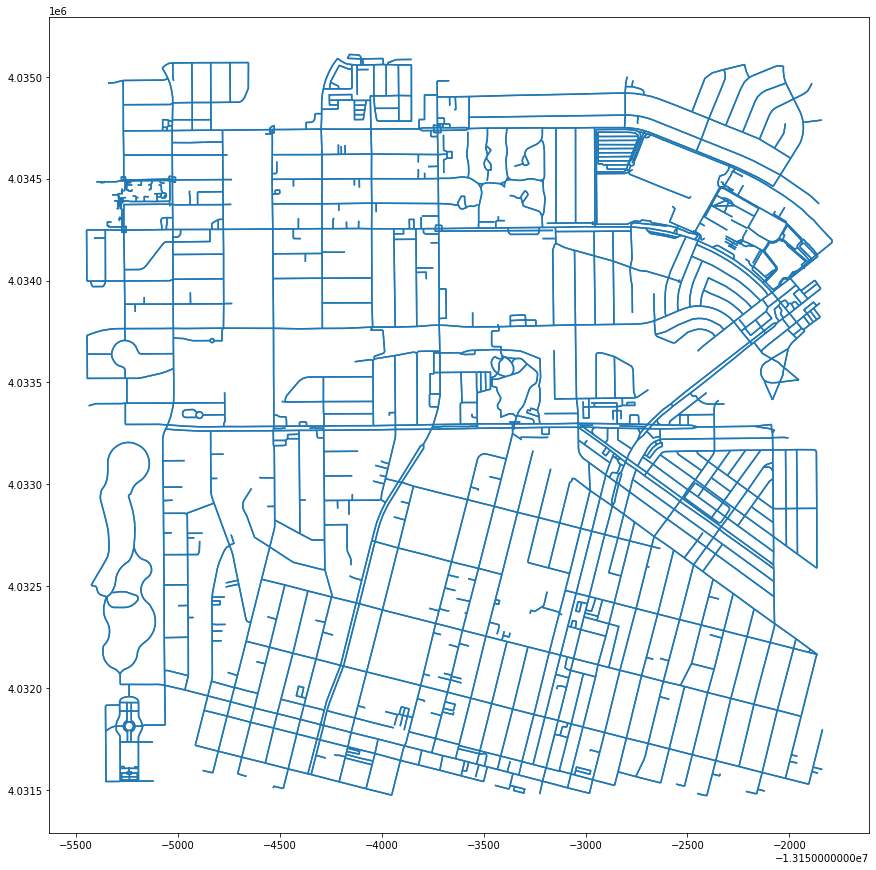

In [13]:
gdf_edges.plot(figsize=(15,15))

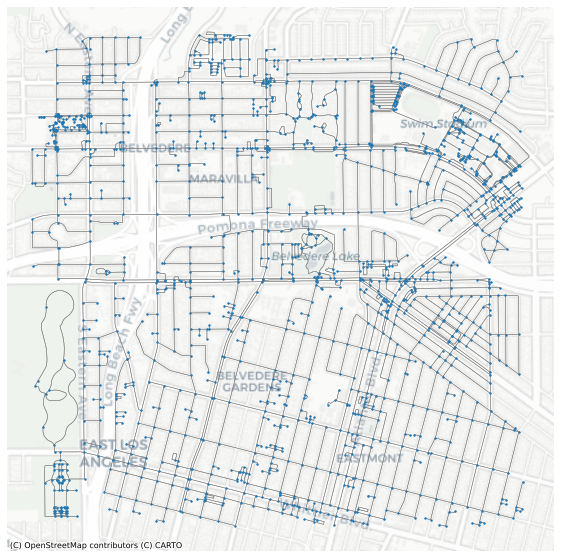

In [14]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [27]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13155448.347495379
4031471.857767747
-13151837.354721077
4035089.507649423


In [28]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13153642.851108227
4033280.6827085847


In [29]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 269612210


In [30]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
269612210,4.033295e+06,-1.315361e+07,NaN,3,-118.160921,34.033453,POINT (-13153613.569 4033294.845)


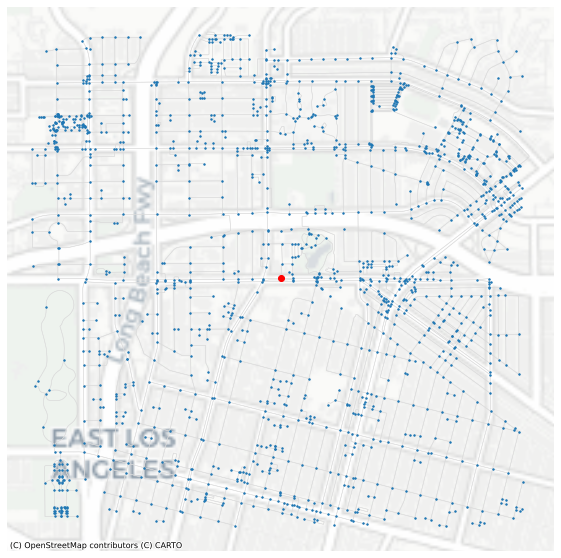

In [34]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron, zoom=14)

In [35]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel
u,v,key,,,,,,,,,,,,,
4002742097,122743561,0,13317761,NaN,Via Corona Street,residential,NaN,False,11.343,"LINESTRING (-13152849.082 4033008.783, -131528...",NaN,NaN,NaN,NaN,NaN
8840721732,8840721727,0,955178539,NaN,NaN,footway,NaN,False,36.837,"LINESTRING (-13152318.700 4034333.292, -131522...",NaN,NaN,NaN,NaN,NaN
122620559,122620558,0,162804731,NaN,East 4th Street,residential,NaN,False,111.747,"LINESTRING (-13153448.215 4032891.826, -131535...",NaN,NaN,NaN,NaN,NaN
8777112427,8777112368,0,948222684,NaN,NaN,footway,NaN,False,15.124,"LINESTRING (-13155313.740 4034390.844, -131552...",NaN,NaN,NaN,NaN,NaN
123385034,123017131,0,13409181,NaN,Repetto Street,residential,NaN,False,100.061,"LINESTRING (-13152275.597 4032464.081, -131523...",NaN,NaN,NaN,NaN,NaN


In [36]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [37]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,
123129306,6735543655,0,608182982,NaN,South la Verne Avenue,residential,NaN,False,40.092,"LINESTRING (-13153677.221 4031979.751, -131536...",NaN,NaN,NaN,NaN,NaN,0.501150
8777112436,8777112432,0,948222698,NaN,NaN,footway,NaN,False,9.388,"LINESTRING (-13155194.205 4034407.542, -131552...",NaN,NaN,NaN,NaN,NaN,0.117350
1743923266,1743923279,0,46240930,NaN,NaN,service,NaN,False,15.490,"LINESTRING (-13155283.361 4031564.852, -131552...",permissive,NaN,NaN,NaN,NaN,0.193625
1746242088,7875671480,0,162810376,NaN,Eagle Street,residential,NaN,False,27.625,"LINESTRING (-13152982.265 4032449.467, -131529...",NaN,NaN,NaN,NaN,NaN,0.345313
7466704378,3642959047,0,359621439,NaN,East Hastings Street,residential,NaN,False,54.757,"LINESTRING (-13152944.082 4032331.885, -131529...",NaN,NaN,NaN,NaN,NaN,0.684462


In [38]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [39]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [42]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 269612210, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 271 nodes within 10 minutes 


In [43]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1099756402,4.034456e+06,-1.315351e+07,NaN,3,-118.160032,34.042096,POINT (-13153514.550 4034455.905),NaN,NaN
123232931,4.031614e+06,-1.315348e+07,NaN,3,-118.159742,34.020936,POINT (-13153482.289 4031613.633),NaN,NaN
3388016220,4.034005e+06,-1.315254e+07,NaN,1,-118.151261,34.038737,POINT (-13152538.200 4034004.659),NaN,NaN
122658911,4.033645e+06,-1.315371e+07,NaN,4,-118.161832,34.036058,POINT (-13153714.914 4033644.709),10 mins,#0d0887
253126387,4.031511e+06,-1.315309e+07,NaN,3,-118.156203,34.020170,POINT (-13153088.385 4031510.686),NaN,NaN
6738150130,4.034254e+06,-1.315386e+07,NaN,3,-118.163171,34.040593,POINT (-13153863.993 4034253.910),NaN,NaN
8840721631,4.034052e+06,-1.315208e+07,NaN,1,-118.147116,34.039088,POINT (-13152076.781 4034051.758),NaN,NaN
269612807,4.033412e+06,-1.315235e+07,turning_circle,1,-118.149541,34.034327,POINT (-13152346.697 4033412.209),NaN,NaN
122813389,4.034616e+06,-1.315503e+07,NaN,4,-118.173627,34.043286,POINT (-13155027.949 4034615.760),NaN,NaN


In [44]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [45]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
8777112165,4.034247e+06,-1.315525e+07,NaN,4,-118.175662,34.040543,POINT (-13155254.518 4034247.314),NaN,#cccccc
7875671480,4.032441e+06,-1.315295e+07,NaN,3,-118.154960,34.027098,POINT (-13152949.937 4032441.193),NaN,#cccccc
6735903095,4.032259e+06,-1.315340e+07,NaN,3,-118.159041,34.025739,POINT (-13153404.254 4032258.602),NaN,#cccccc
1099757664,4.034294e+06,-1.315343e+07,NaN,3,-118.159252,34.040891,POINT (-13153427.732 4034293.944),NaN,#cccccc
6726347342,4.031472e+06,-1.315241e+07,NaN,3,-118.150065,34.019881,POINT (-13152405.073 4031471.858),NaN,#cccccc


<AxesSubplot:>

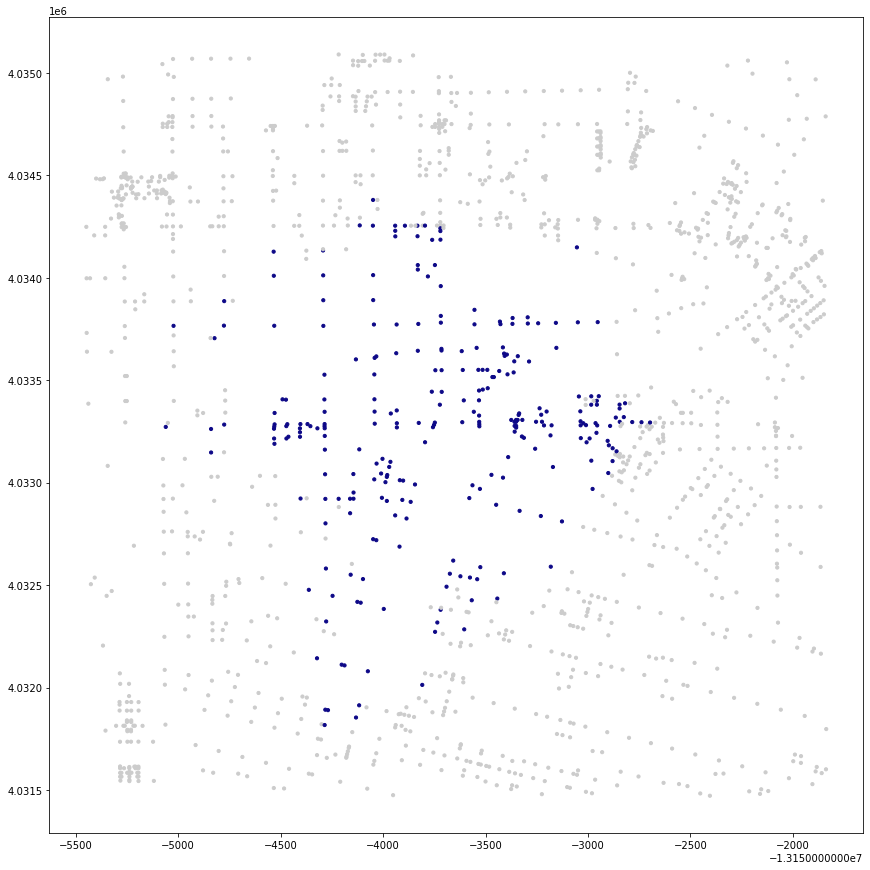

In [46]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

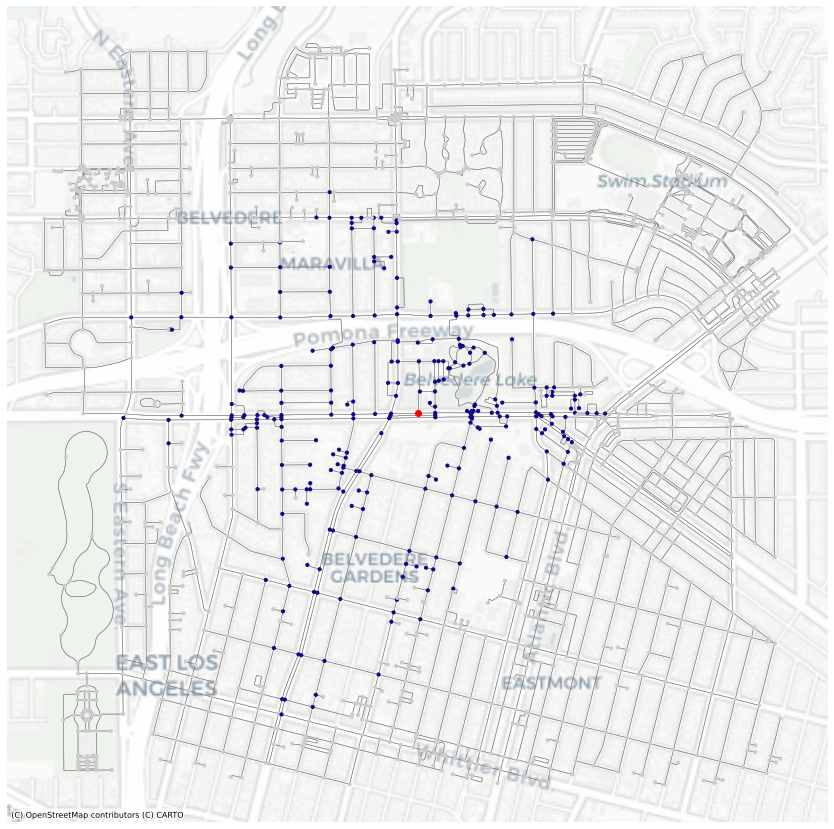

In [48]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [49]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6816488222,4.034241e+06,-1.315372e+07,NaN,4,-118.161882,34.040497,POINT (-13153720.558 4034241.067),10 mins,#0d0887
74673066,4.034127e+06,-1.315453e+07,traffic_signals,3,-118.169191,34.039649,POINT (-13154534.158 4034127.121),10 mins,#0d0887
6735157126,4.031892e+06,-1.315428e+07,NaN,3,-118.166926,34.023007,POINT (-13154282.009 4031891.776),10 mins,#0d0887
1742549940,4.031817e+06,-1.315429e+07,traffic_signals,4,-118.166954,34.022450,POINT (-13154285.181 4031816.938),10 mins,#0d0887
122584279,4.034009e+06,-1.315453e+07,NaN,3,-118.169183,34.038773,POINT (-13154533.324 4034009.495),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8361650777,4.033306e+06,-1.315332e+07,NaN,1,-118.158287,34.033536,POINT (-13153320.320 4033305.954),10 mins,#0d0887
8361650775,4.033306e+06,-1.315337e+07,NaN,1,-118.158774,34.033535,POINT (-13153374.566 4033305.806),10 mins,#0d0887
8361650779,4.033268e+06,-1.315335e+07,NaN,1,-118.158558,34.033256,POINT (-13153350.543 4033268.382),10 mins,#0d0887


In [50]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

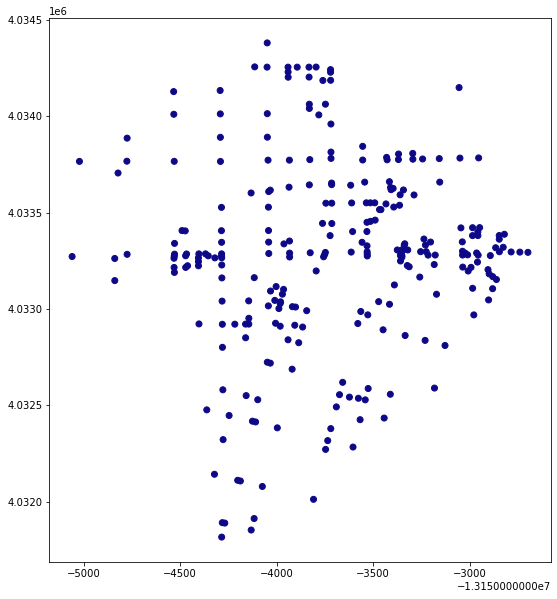

In [51]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

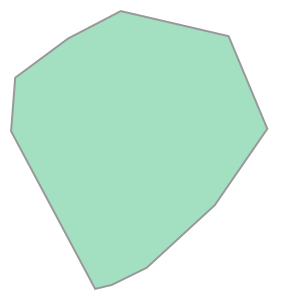

In [52]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [53]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13155060.722 4033271.808, -131550...",4.034241e+06,-1.315372e+07,traffic_signals,4,-118.161882,34.040497,#0d0887


In [54]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


In [55]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


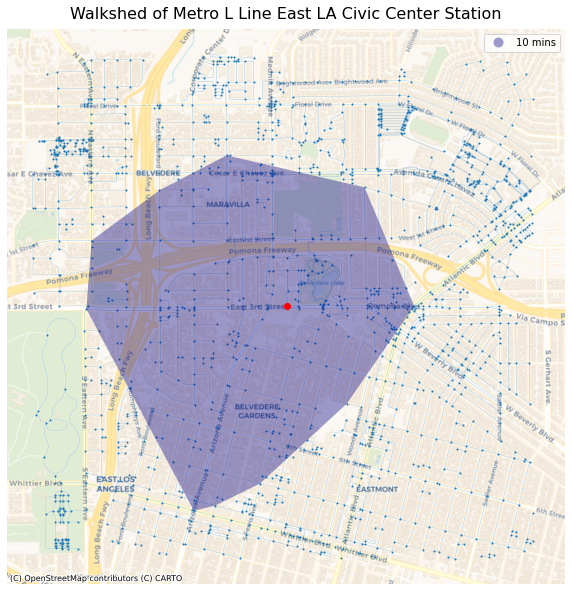

In [57]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line East LA Civic Center Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Mariachi Plaza Station

In [58]:
# Let's start by orienting ourselves around the Mariachi Plaza Station by calling for it by address in osmnx

address = 'Mariachi Plaza, Metro Gold Line Entrance, Brooklyn Heights, Boyle Heights, Los Angeles, Los Angeles County, California, 90033, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [59]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.53 s, sys: 61 ms, total: 3.59 s
Wall time: 9.56 s


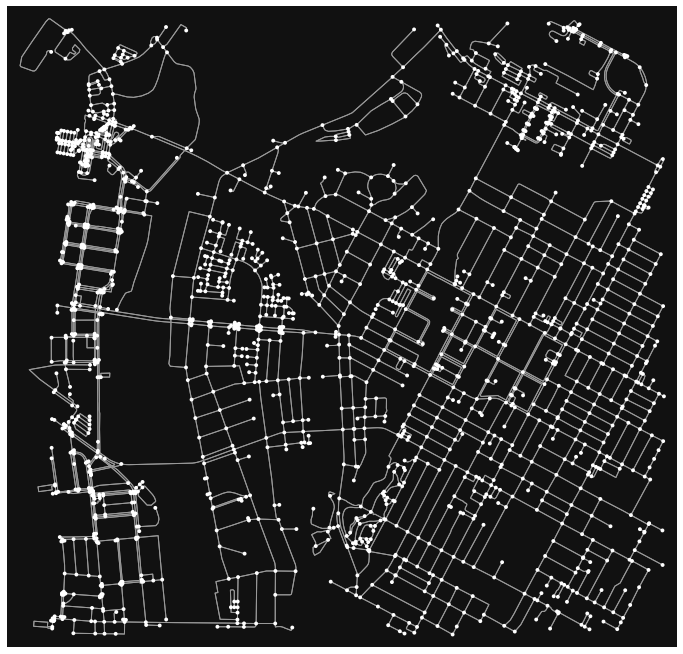

In [60]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [61]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [62]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [63]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14941481,4.036783e+06,-1.315848e+07,stop,3,-118.204655,34.059417,POINT (-13158481.982 4036783.097)
8772109642,4.036793e+06,-1.315848e+07,crossing,4,-118.204605,34.059495,POINT (-13158476.416 4036793.498)
604238739,4.036724e+06,-1.315839e+07,NaN,4,-118.203870,34.058981,POINT (-13158394.652 4036724.445)
15373745,4.036812e+06,-1.315854e+07,NaN,3,-118.205136,34.059632,POINT (-13158535.560 4036812.014)
14941485,4.036619e+06,-1.315836e+07,NaN,3,-118.203524,34.058197,POINT (-13158356.146 4036619.141)


<AxesSubplot:>

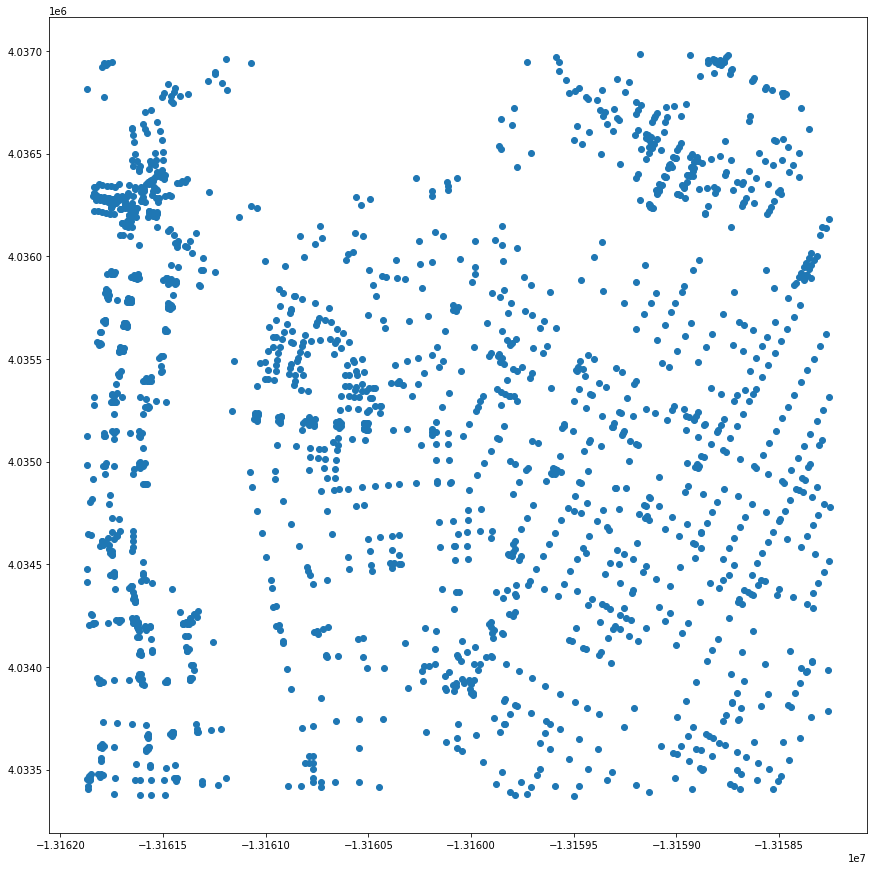

In [64]:
gdf_nodes.plot(figsize=(15,15))

In [65]:
gdf_edges.head()

osmid              name      highway  oneway  \
u          v          key                                                     
14941481   8772109642 0    161709222  San Pablo Street  residential   False   
           604238739  0    161709223      Zonal Avenue  residential   False   
           15373745   0    161709223      Zonal Avenue  residential   False   
8772109642 14941481   0    161709222  San Pablo Street  residential   False   
           8772216945 0    947706656               NaN      footway   False   

                           length  \
u          v          key           
14941481   8772109642 0     9.762   
           604238739  0    87.618   
           15373745   0    50.384   
8772109642 14941481   0     9.762   
           8772216945 0     9.079   

                                                                    geometry  \
u          v          key                                                      
14941481   8772109642 0    LINESTRING (-13158481.982 4036783.097, -131584...   
           604238739  0    LINESTRING (-13158481.982 4036783.097, -131584...   
           15373745   0    LINESTRING (-13158481.982 4036783.097, -131584...   
8772109642 14941481   0    LINESTRING (-13158476.416 4036793.498, -131584...   
           8772216945 0    LINESTRING (-13158476.416 4036793.498, -131584...   

                          lanes maxspeed access bridge service tunnel width  
u          v          key                                                    
14941481   8772109642 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           604238739  0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           15373745   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
8772109642 14941481   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           8772216945 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN

<AxesSubplot:>

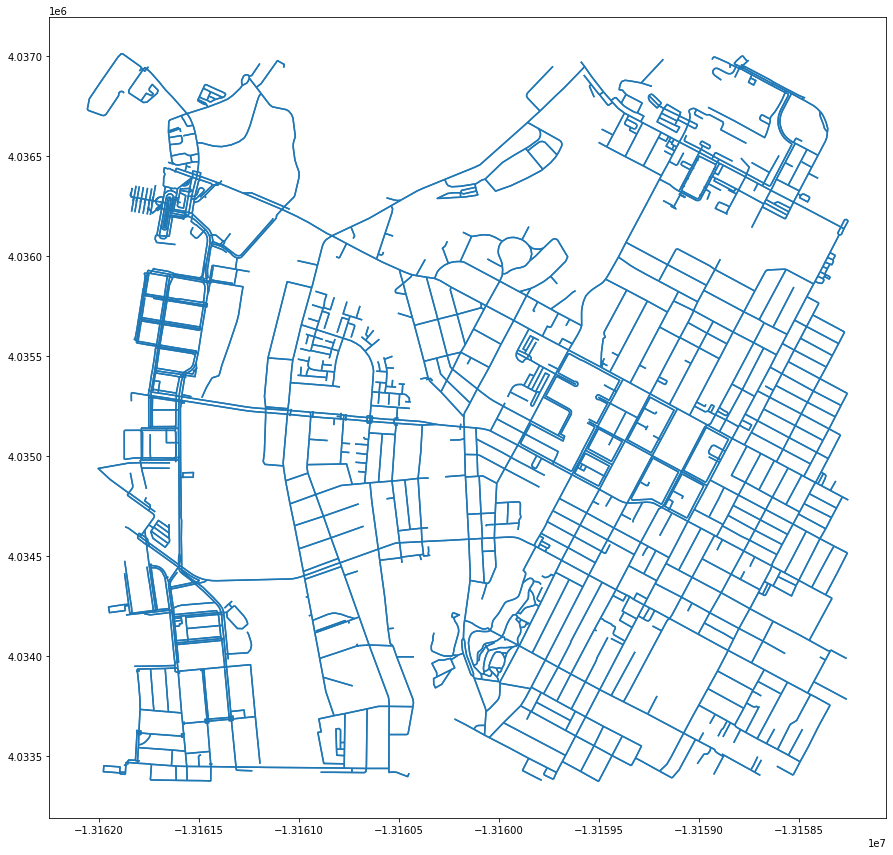

In [66]:
gdf_edges.plot(figsize=(15,15))

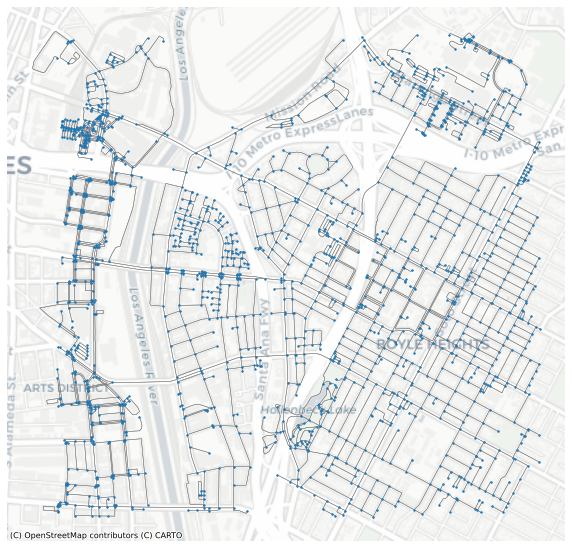

In [67]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [68]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161872.984927278
4033373.0514499233
-13158251.594912536
4036983.296539621


In [69]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13160062.289919907
4035178.173994772


In [70]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 2935903748


In [71]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
2935903748,4.035186e+06,-1.316001e+07,NaN,3,-118.218374,34.047528,POINT (-13160009.241 4035185.662)


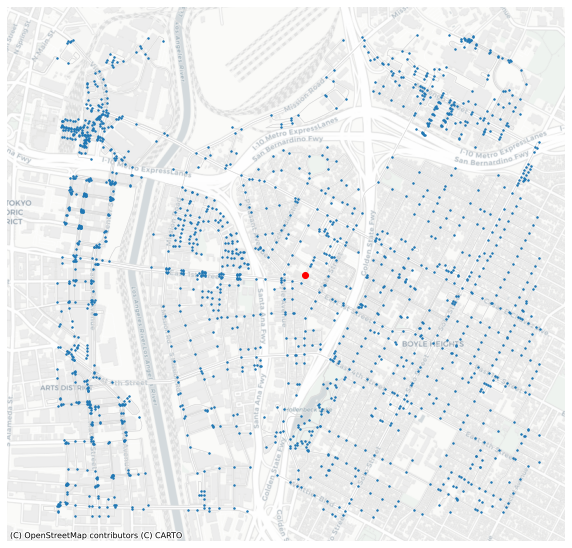

In [72]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [73]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width
u,v,key,,,,,,,,,,,,,
9484508111,9484508114,0,1028756428,NaN,footway,False,101.416,"LINESTRING (-13159060.676 4036603.339, -131590...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
604238291,604238292,0,390225963,East 4th Street,primary,False,2.990,"LINESTRING (-13160080.608 4034587.763, -131600...",4,35 mph,NaN,NaN,NaN,NaN,NaN
8411018796,8411018798,0,905718175,NaN,service,False,45.545,"LINESTRING (-13158718.925 4034495.671, -131587...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6817267576,6817267577,0,727451448,NaN,service,False,31.485,"LINESTRING (-13160522.423 4034791.040, -131605...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6587771977,1997435522,0,189097628,NaN,service,False,53.848,"LINESTRING (-13158551.879 4035471.658, -131585...",NaN,NaN,NaN,NaN,alley,NaN,NaN


In [74]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [75]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
268546677,6784443633,0,"[399264811, 723319420]",Vignes Street,secondary,False,47.825,"LINESTRING (-13161507.479 4036566.388, -131615...","[4, 5]",NaN,NaN,NaN,NaN,NaN,NaN,0.597813
1997435525,3694133335,0,189097628,NaN,service,False,54.654,"LINESTRING (-13158704.676 4035175.881, -131586...",NaN,NaN,NaN,NaN,alley,NaN,NaN,0.683175
9109585029,2171893669,0,207068982,NaN,service,False,136.423,"LINESTRING (-13161394.389 4034152.041, -131613...",NaN,NaN,no,NaN,NaN,NaN,NaN,1.705288
122740435,1997435510,0,13306721,Folsom Street,residential,False,147.510,"LINESTRING (-13158486.746 4035210.329, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.843875
8749722726,8749722727,0,945100733,NaN,service,False,27.767,"LINESTRING (-13160820.849 4035187.798, -131608...",NaN,NaN,customers,NaN,NaN,NaN,NaN,0.347087


In [76]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [77]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [79]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 2935903748, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 287 nodes within 10 minutes 


In [80]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
122620359,4.034575e+06,-1.316176e+07,NaN,4,-118.234121,34.042983,POINT (-13161762.144 4034575.094),NaN,NaN
9095385773,4.034335e+06,-1.316164e+07,crossing,4,-118.233022,34.041194,POINT (-13161639.804 4034334.689),NaN,NaN
6587771972,4.034608e+06,-1.315856e+07,NaN,3,-118.205312,34.043228,POINT (-13158555.163 4034607.915),NaN,NaN
123490615,4.034506e+06,-1.316039e+07,NaN,3,-118.221834,34.042468,POINT (-13160394.328 4034505.908),NaN,NaN
2171884123,4.033727e+06,-1.316172e+07,NaN,3,-118.233769,34.036670,POINT (-13161723.015 4033727.042),NaN,NaN
7867421451,4.033723e+06,-1.315984e+07,NaN,3,-118.216843,34.036642,POINT (-13159838.777 4033723.173),NaN,NaN
4219849877,4.035444e+06,-1.315949e+07,NaN,3,-118.213695,34.049452,POINT (-13159488.310 4035444.129),10 mins,#0d0887
4409000544,4.036283e+06,-1.316177e+07,NaN,3,-118.234162,34.055697,POINT (-13161766.764 4036283.240),NaN,NaN
9448171657,4.035781e+06,-1.316167e+07,NaN,3,-118.233324,34.051957,POINT (-13161673.456 4035780.690),NaN,NaN


In [81]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [82]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
9456247866,4.035503e+06,-1.316152e+07,NaN,3,-118.231936,34.049891,POINT (-13161518.933 4035503.151),NaN,#cccccc
604238482,4.033748e+06,-1.315870e+07,NaN,1,-118.206585,34.036827,POINT (-13158696.795 4033748.025),NaN,#cccccc
1836149479,4.035740e+06,-1.316009e+07,NaN,3,-118.219103,34.051655,POINT (-13160090.292 4035740.114),10 mins,#0d0887
123285244,4.035754e+06,-1.316146e+07,stop,4,-118.231438,34.051760,POINT (-13161463.474 4035754.303),NaN,#cccccc
6481780217,4.034971e+06,-1.315972e+07,crossing,4,-118.215814,34.045929,POINT (-13159724.196 4034970.783),10 mins,#0d0887


<AxesSubplot:>

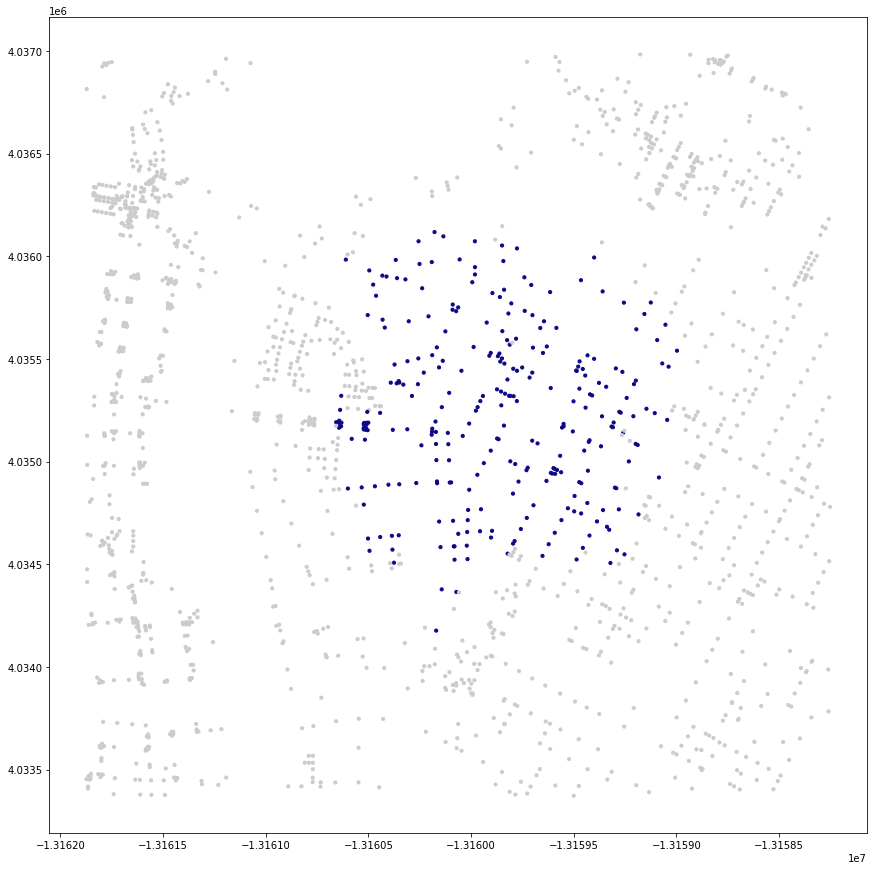

In [83]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

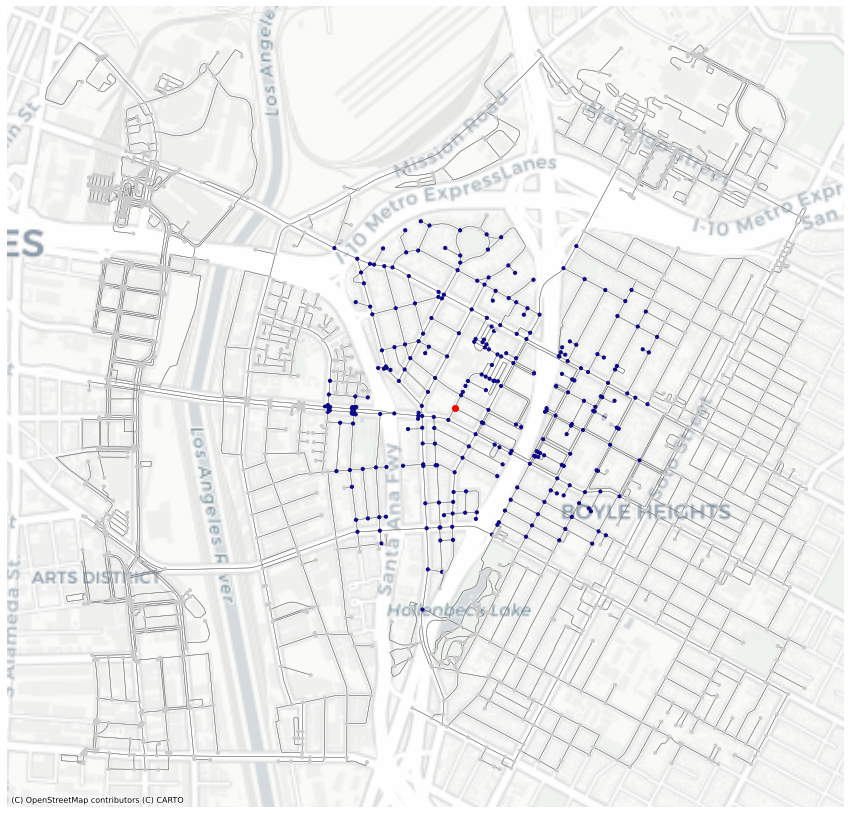

In [85]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[2935903748]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [86]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
15713713,4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,POINT (-13160148.902 4034583.948),10 mins,#0d0887
604238292,4.034588e+06,-1.316008e+07,NaN,3,-118.219048,34.043076,POINT (-13160084.214 4034587.562),10 mins,#0d0887
72744268,4.034572e+06,-1.316038e+07,NaN,4,-118.221731,34.042958,POINT (-13160382.907 4034571.655),10 mins,#0d0887
604238295,4.034708e+06,-1.316016e+07,NaN,3,-118.219688,34.043976,POINT (-13160155.503 4034708.498),10 mins,#0d0887
123413088,4.034378e+06,-1.316014e+07,NaN,3,-118.219576,34.041517,POINT (-13160143.013 4034378.068),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7875081594,4.035722e+06,-1.315982e+07,NaN,1,-118.216658,34.051518,POINT (-13159818.138 4035721.748),10 mins,#0d0887
8395946642,4.034758e+06,-1.315950e+07,NaN,1,-118.213780,34.044345,POINT (-13159497.750 4034757.991),10 mins,#0d0887
8395946644,4.034748e+06,-1.315946e+07,NaN,1,-118.213476,34.044269,POINT (-13159463.975 4034747.888),10 mins,#0d0887


In [87]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

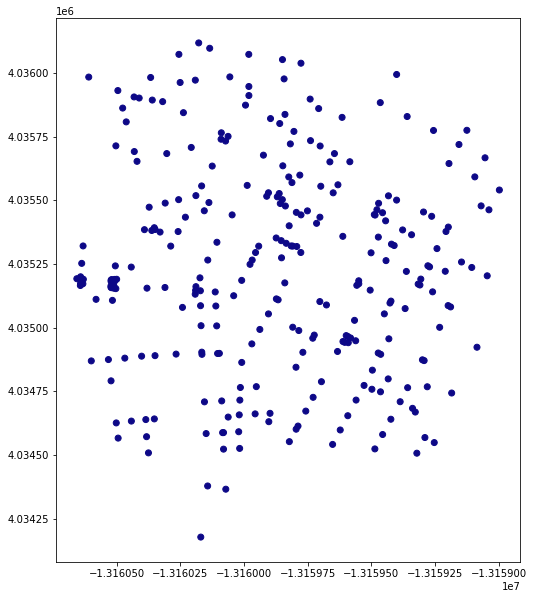

In [88]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

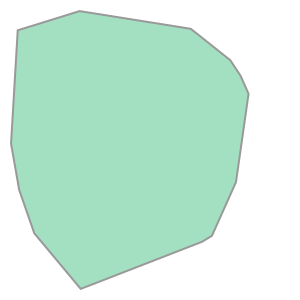

In [89]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [90]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13160656.853 4035192.232, -131606...",4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,#0d0887


In [91]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


In [92]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


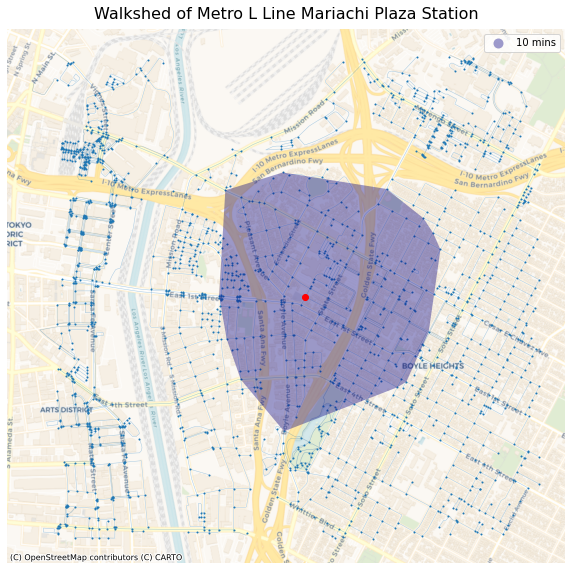

In [94]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Mariachi Plaza Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Chinatown Station

In [95]:
address = 'Chinatown Station, College Street, New Chinatown, Chinatown, Los Angeles, Los Angeles County, California, 90012, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [96]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 4.83 s, sys: 52.3 ms, total: 4.89 s
Wall time: 19.3 s


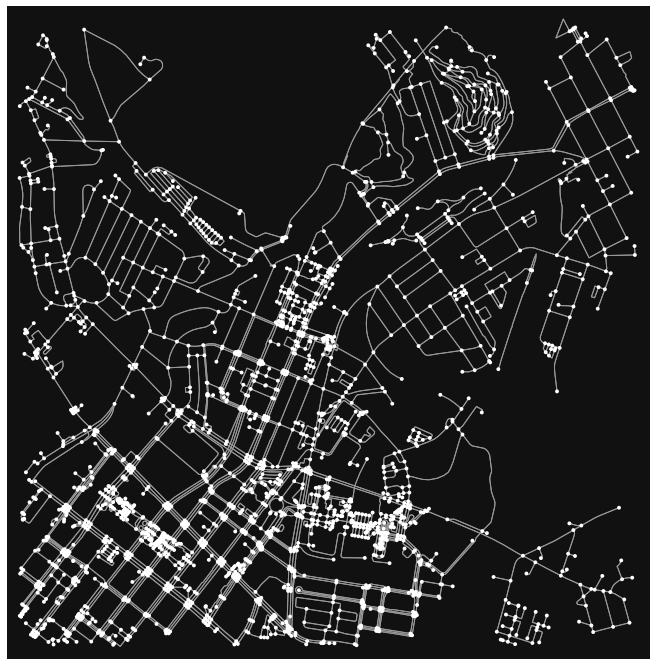

In [97]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [98]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [99]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [100]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
15027548,4.039027e+06,-1.316061e+07,3,-118.223785,34.076114,NaN,POINT (-13160611.557 4039026.875)
67619407,4.039118e+06,-1.316050e+07,4,-118.222746,34.076796,traffic_signals,POINT (-13160495.907 4039118.493)
123283621,4.038908e+06,-1.316055e+07,3,-118.223245,34.075226,NaN,POINT (-13160551.456 4038907.559)
15027549,4.038710e+06,-1.316045e+07,4,-118.222311,34.073758,traffic_signals,POINT (-13160447.416 4038710.296)
3723806094,4.038716e+06,-1.316045e+07,4,-118.222338,34.073802,NaN,POINT (-13160450.467 4038716.075)


### Plotting the station area

<AxesSubplot:>

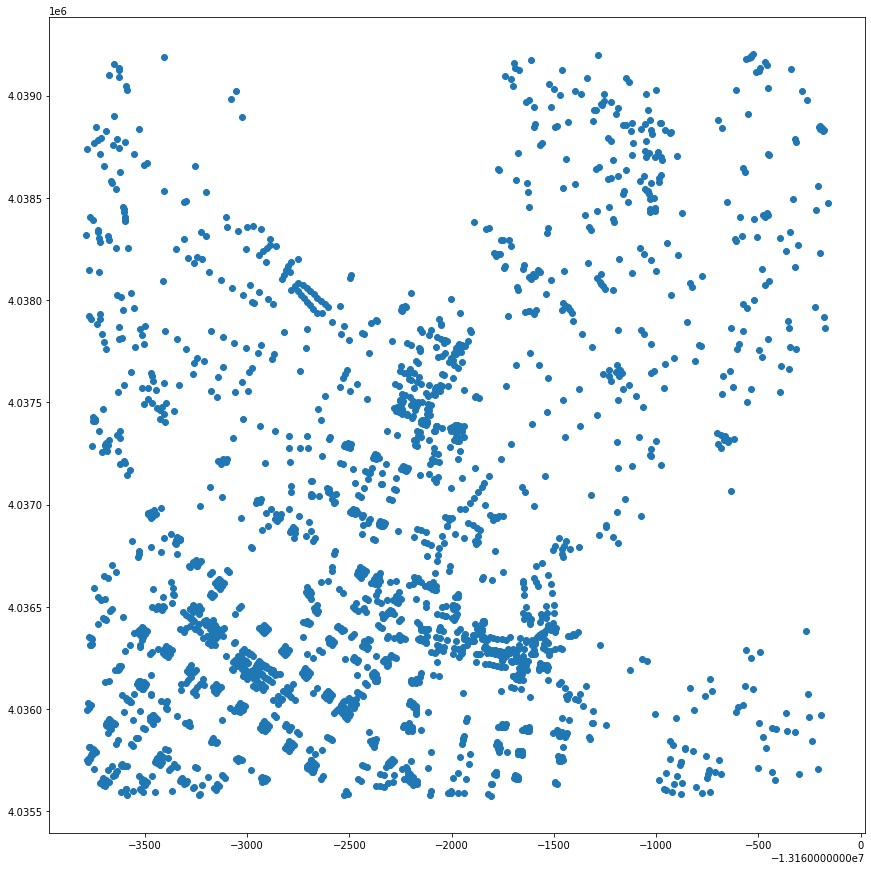

In [101]:
gdf_nodes.plot(figsize=(15,15))

In [102]:
gdf_edges.head()

osmid               name    highway  oneway  \
u        v          key                                                    
15027548 67619407   0      9126419    Humboldt Street   tertiary   False   
         123283621  0    358037415          Avenue 19   tertiary   False   
67619407 7871476832 0      9126419    Humboldt Street   tertiary   False   
         6787624912 0    398398790  San Fernando Road  secondary   False   
         15027548   0      9126419    Humboldt Street   tertiary   False   

                          length  \
u        v          key            
15027548 67619407   0    122.072   
         123283621  0    110.537   
67619407 7871476832 0     41.864   
         6787624912 0     67.319   
         15027548   0    122.072   

                                                                  geometry  \
u        v          key                                                      
15027548 67619407   0    LINESTRING (-13160611.557 4039026.875, -131605...   
         123283621  0    LINESTRING (-13160611.557 4039026.875, -131606...   
67619407 7871476832 0    LINESTRING (-13160495.907 4039118.493, -131604...   
         6787624912 0    LINESTRING (-13160495.907 4039118.493, -131605...   
         15027548   0    LINESTRING (-13160495.907 4039118.493, -131605...   

                        lanes maxspeed bridge service access tunnel width  
u        v          key                                                    
15027548 67619407   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         123283621  0       2      NaN    NaN     NaN    NaN    NaN   NaN  
67619407 7871476832 0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         6787624912 0       4      NaN    NaN     NaN    NaN    NaN   NaN  
         15027548   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN

<AxesSubplot:>

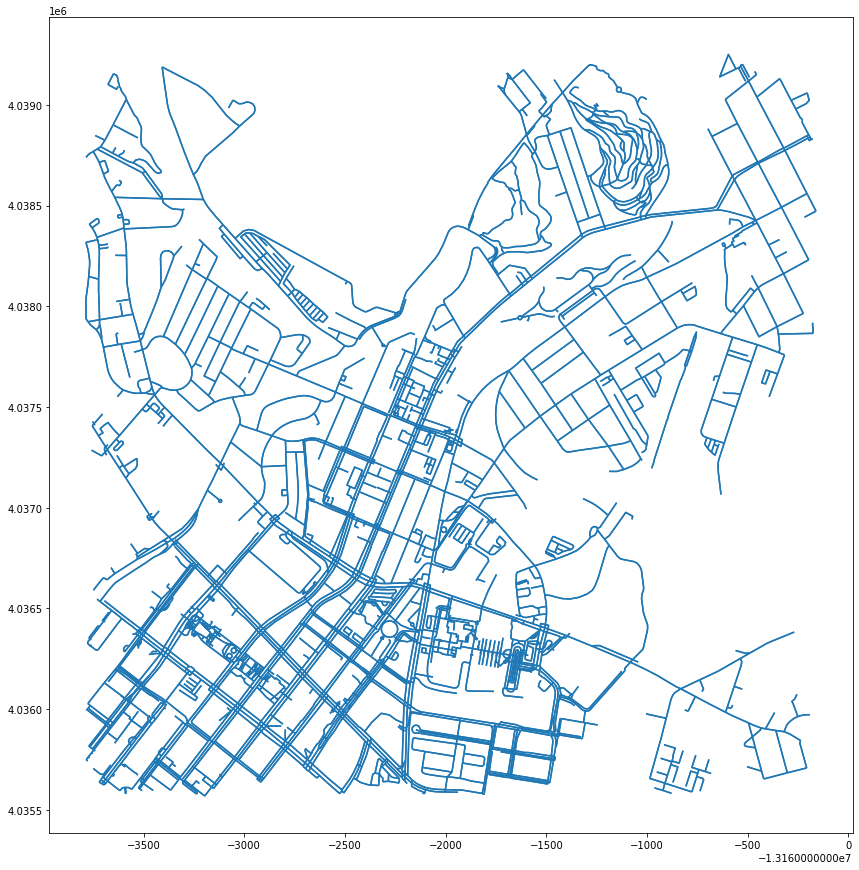

In [103]:
gdf_edges.plot(figsize=(15,15))

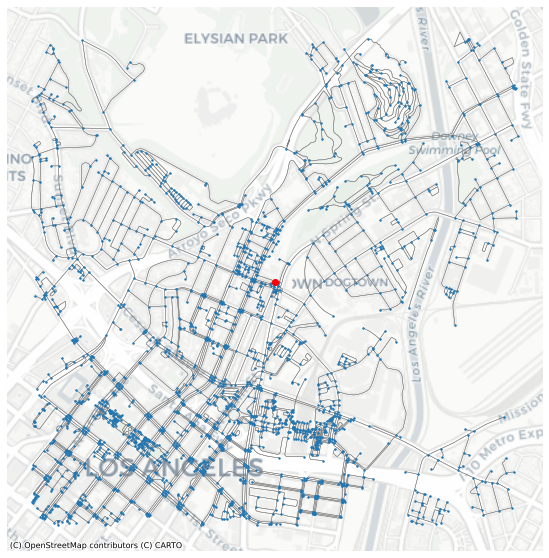

In [104]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [105]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width
u,v,key,,,,,,,,,,,,,
3215839084,123396147,0,207978276,West 4th Street,primary,False,10.448,"LINESTRING (-13163687.860 4035631.286, -131636...",4,25 mph,NaN,NaN,NaN,NaN,NaN
122945271,60945763,0,472809537,Centennial Street,residential,False,106.801,"LINESTRING (-13163118.784 4037675.038, -131630...",2,NaN,NaN,NaN,NaN,NaN,NaN
4454249226,9212741997,0,997771071,NaN,footway,False,8.965,"LINESTRING (-13161568.949 4036350.879, -131615...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1738813491,268651448,0,161930186,North Hill Street,secondary,False,140.267,"LINESTRING (-13162694.334 4036546.771, -131626...",4,NaN,NaN,NaN,NaN,NaN,NaN
6726508710,6726508703,0,715752191,NaN,service,False,6.368,"LINESTRING (-13163601.521 4037210.723, -131635...",NaN,NaN,NaN,driveway,NaN,NaN,NaN


In [106]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [107]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
6474121671,6471392400,0,958988197,NaN,footway,False,85.886,"LINESTRING (-13162970.116 4036112.425, -131630...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.073575
3636122618,1966359031,0,449824702,NaN,footway,False,6.026,"LINESTRING (-13163532.625 4036129.851, -131635...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.075325
8397761157,6784759082,0,523661837,South Hill Street,secondary,False,26.447,"LINESTRING (-13163506.086 4035634.282, -131635...",2,NaN,NaN,NaN,NaN,NaN,NaN,0.330587
3898644931,8873450855,0,958988193,NaN,footway,False,9.006,"LINESTRING (-13163161.464 4036406.278, -131631...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.112575
122391280,6726354675,0,305932492,Stadium Way,tertiary,False,269.982,"LINESTRING (-13162543.151 4037834.790, -131625...",2,NaN,NaN,NaN,NaN,NaN,NaN,3.374775


In [108]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [109]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [110]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 8290553634, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 173 nodes within 10 minutes 


In [111]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
6883792678,4.037489e+06,-1.316211e+07,4,-118.237276,34.064674,NaN,POINT (-13162113.390 4037489.474),10 mins,#0d0887
9032969261,4.036701e+06,-1.316324e+07,3,-118.247439,34.058807,crossing,POINT (-13163244.719 4036701.092),NaN,NaN
2178255369,4.036078e+06,-1.316259e+07,4,-118.241598,34.054171,crossing,POINT (-13162594.447 4036078.149),NaN,NaN
8252694209,4.035595e+06,-1.316362e+07,3,-118.250781,34.050575,NaN,POINT (-13163616.716 4035594.969),NaN,NaN
9074390821,4.035778e+06,-1.316166e+07,3,-118.233187,34.051938,crossing,POINT (-13161658.116 4035778.097),NaN,NaN
1738812373,4.036937e+06,-1.316203e+07,3,-118.236542,34.060565,traffic_signals,POINT (-13162031.671 4036937.288),10 mins,#0d0887
8409191472,4.035618e+06,-1.316326e+07,4,-118.247570,34.050746,NaN,POINT (-13163259.235 4035617.957),NaN,NaN
9071150199,4.035885e+06,-1.316147e+07,3,-118.231521,34.052735,crossing,POINT (-13161472.725 4035885.208),NaN,NaN
3144612049,4.037775e+06,-1.316194e+07,3,-118.235677,34.066797,NaN,POINT (-13161935.368 4037774.775),10 mins,#0d0887


In [112]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [113]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
3898644407,4.036258e+06,-1.316310e+07,3,-118.246167,34.055508,NaN,POINT (-13163103.132 4036257.872),NaN,#cccccc
3144612056,4.035841e+06,-1.316318e+07,3,-118.246844,34.052406,NaN,POINT (-13163178.473 4035841.098),NaN,#cccccc
9466976724,4.036946e+06,-1.316175e+07,1,-118.234013,34.060628,NaN,POINT (-13161750.155 4036945.793),NaN,#cccccc
9466976726,4.036444e+06,-1.316198e+07,3,-118.236094,34.056895,crossing,POINT (-13161981.811 4036444.236),NaN,#cccccc
3259253740,4.036027e+06,-1.316340e+07,4,-118.248822,34.053791,crossing,POINT (-13163398.663 4036027.092),NaN,#cccccc


<AxesSubplot:>

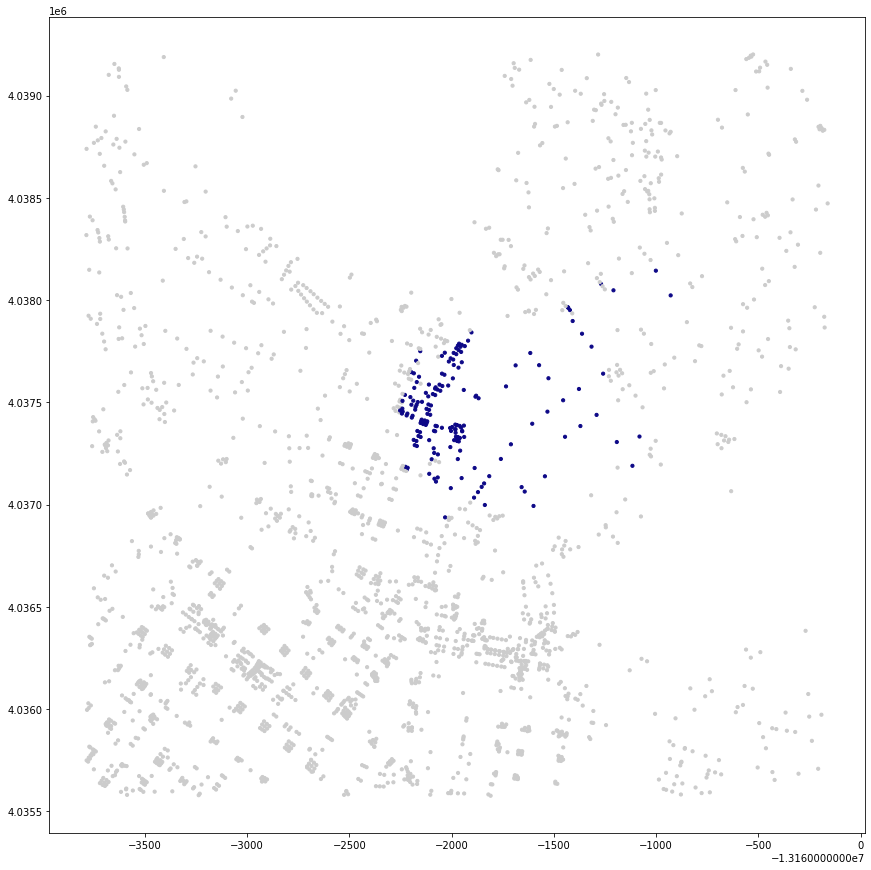

In [114]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

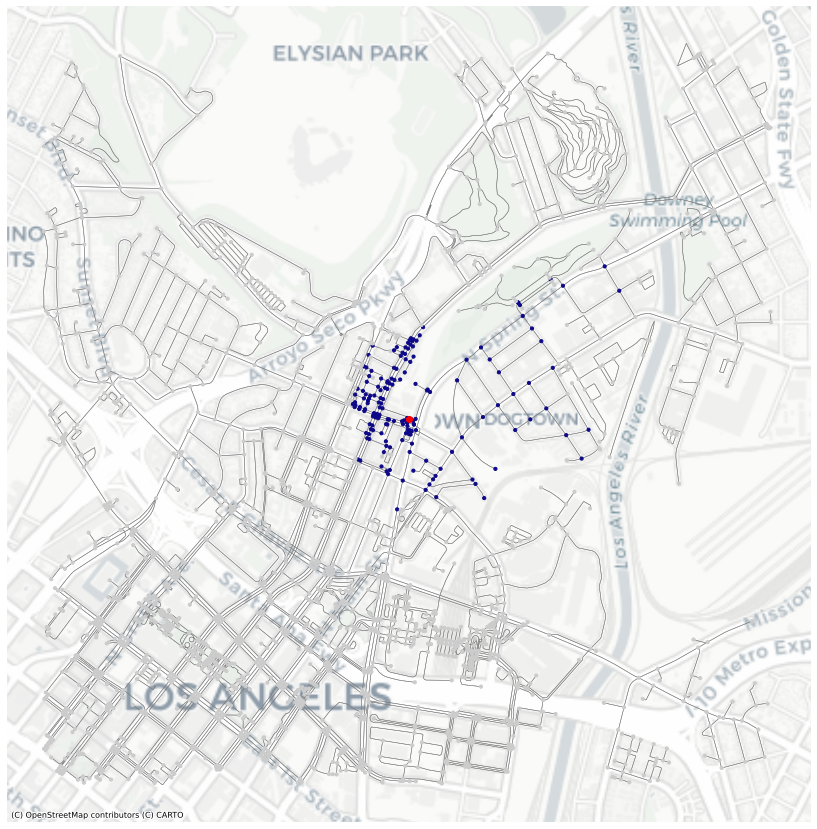

In [115]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [116]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
15717265,4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,POINT (-13161001.164 4038143.644),10 mins,#0d0887
122656713,4.038023e+06,-1.316093e+07,4,-118.226635,34.068642,NaN,POINT (-13160928.751 4038022.752),10 mins,#0d0887
123037729,4.038048e+06,-1.316121e+07,4,-118.229147,34.068827,NaN,POINT (-13161208.430 4038047.599),10 mins,#0d0887
17677673,4.037351e+06,-1.316198e+07,3,-118.236082,34.063645,NaN,POINT (-13161980.397 4037351.213),10 mins,#0d0887
67619377,4.037281e+06,-1.316201e+07,3,-118.236313,34.063122,NaN,POINT (-13162006.145 4037280.975),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8409454505,4.037529e+06,-1.316211e+07,1,-118.237282,34.064967,NaN,POINT (-13162114.070 4037528.873),10 mins,#0d0887
8409457169,4.037488e+06,-1.316217e+07,3,-118.237797,34.064661,NaN,POINT (-13162171.299 4037487.673),10 mins,#0d0887
8409457171,4.037477e+06,-1.316218e+07,1,-118.237841,34.064580,NaN,POINT (-13162176.286 4037476.802),10 mins,#0d0887


In [117]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

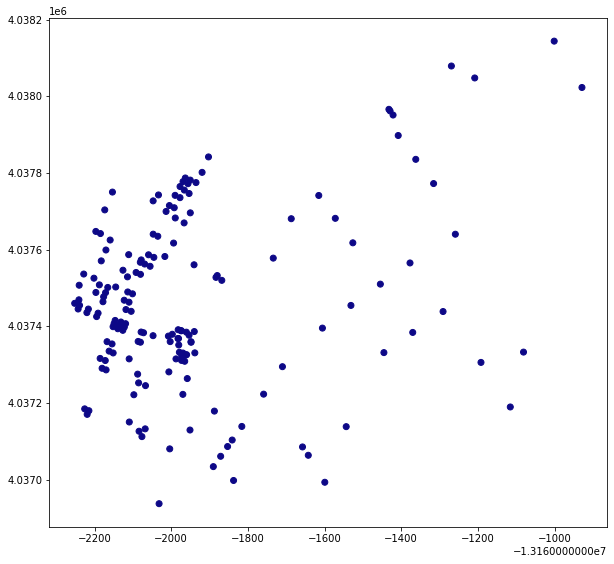

In [118]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

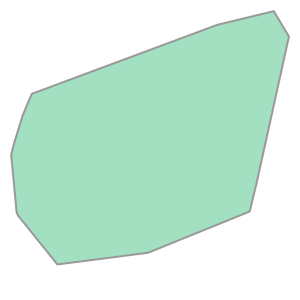

In [119]:
gdf_10.unary_union.convex_hull

There's our polygon! At first we thought it was odd that these haven't been asymettrical shapes. But now we've realized that 10 minutes allows you to reach only certain distances based on how directly connected the route is. For instance, walking down one straight road for ten minutes will allow someone to cover for more geographical ground. But having to zig-zag through a network of grided streets to get to a point, is going to result in covering less geographical ground in 10 minutes


In [120]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13162251.772 4037459.803, -131622...",4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,#0d0887


In [121]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


In [122]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


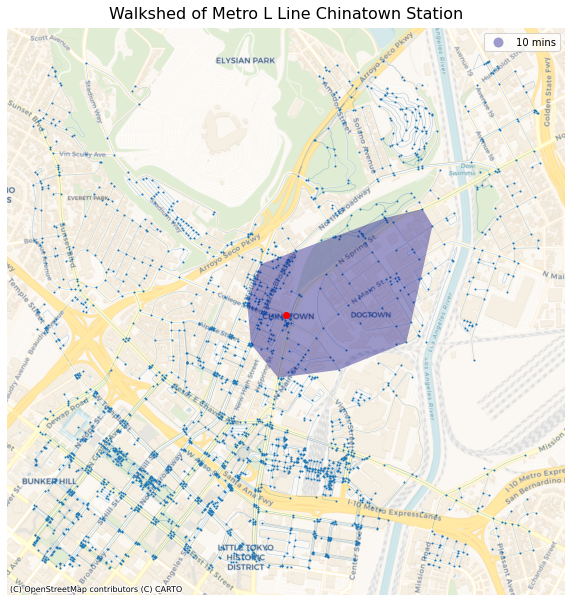

In [123]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Chinatown Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Heritage Square Station

In [124]:
address = 'Heritage Square, Marmion Way, Dayton Avenue, Los Angeles, Los Angeles County, California, 90031-2212, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [125]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.45 s, sys: 35.9 ms, total: 3.49 s
Wall time: 11.1 s


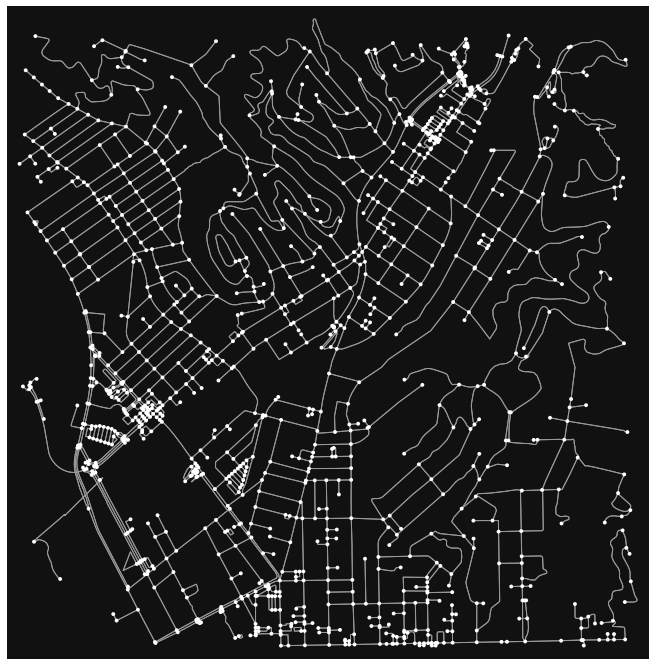

In [126]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [127]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [128]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [129]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10559930,4.040461e+06,-1.316083e+07,traffic_signals,3,-118.225778,34.086785,POINT (-13160833.383 4040461.066)
6872663520,4.040451e+06,-1.316082e+07,NaN,4,-118.225648,34.086711,POINT (-13160818.979 4040451.213)
2156883458,4.040355e+06,-1.316083e+07,NaN,3,-118.225738,34.085997,POINT (-13160828.975 4040355.176)
18660349,4.040552e+06,-1.316084e+07,NaN,3,-118.225864,34.087459,POINT (-13160843.001 4040551.674)
14695503,4.040667e+06,-1.316087e+07,NaN,3,-118.226097,34.088318,POINT (-13160868.883 4040667.177)


### Plotting the station area

<AxesSubplot:>

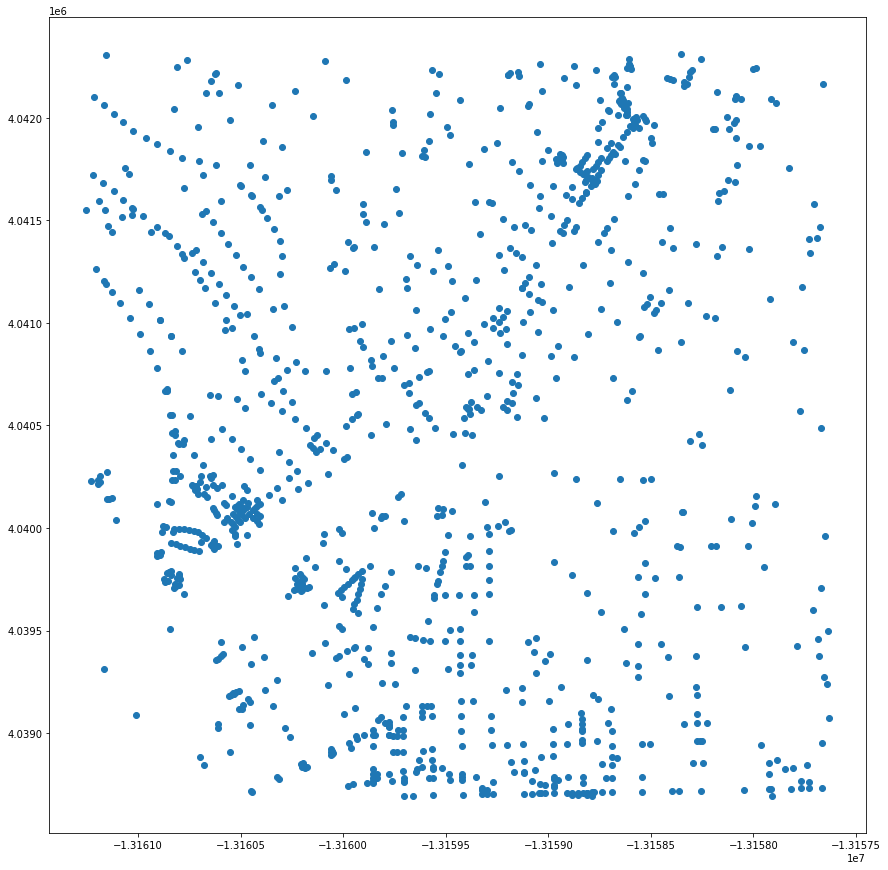

In [130]:
gdf_nodes.plot(figsize=(15,15))

In [131]:
gdf_edges.head()

osmid lanes               name    highway  \
u          v          key                                                  
10559930   6872663520 0    398375445     5     West Avenue 26    primary   
           2156883458 0    104359364   NaN  San Fernando Road  secondary   
           18660349   0    398374225     5  San Fernando Road    primary   
6872663520 10559930   0    398375445     5     West Avenue 26    primary   
           2156883447 0    398375445     5     West Avenue 26    primary   

                           oneway  length  \
u          v          key                   
10559930   6872663520 0     False  14.437   
           2156883458 0     False  87.691   
           18660349   0     False  75.390   
6872663520 10559930   0     False  14.437   
           2156883447 0     False  46.393   

                                                                    geometry  \
u          v          key                                                      
10559930   6872663520 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           2156883458 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           18660349   0    LINESTRING (-13160833.383 4040461.066, -131608...   
6872663520 10559930   0    LINESTRING (-13160818.979 4040451.213, -131608...   
           2156883447 0    LINESTRING (-13160818.979 4040451.213, -131607...   

                          access service maxspeed bridge width tunnel junction  
u          v          key                                                       
10559930   6872663520 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883458 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           18660349   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
6872663520 10559930   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883447 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN

<AxesSubplot:>

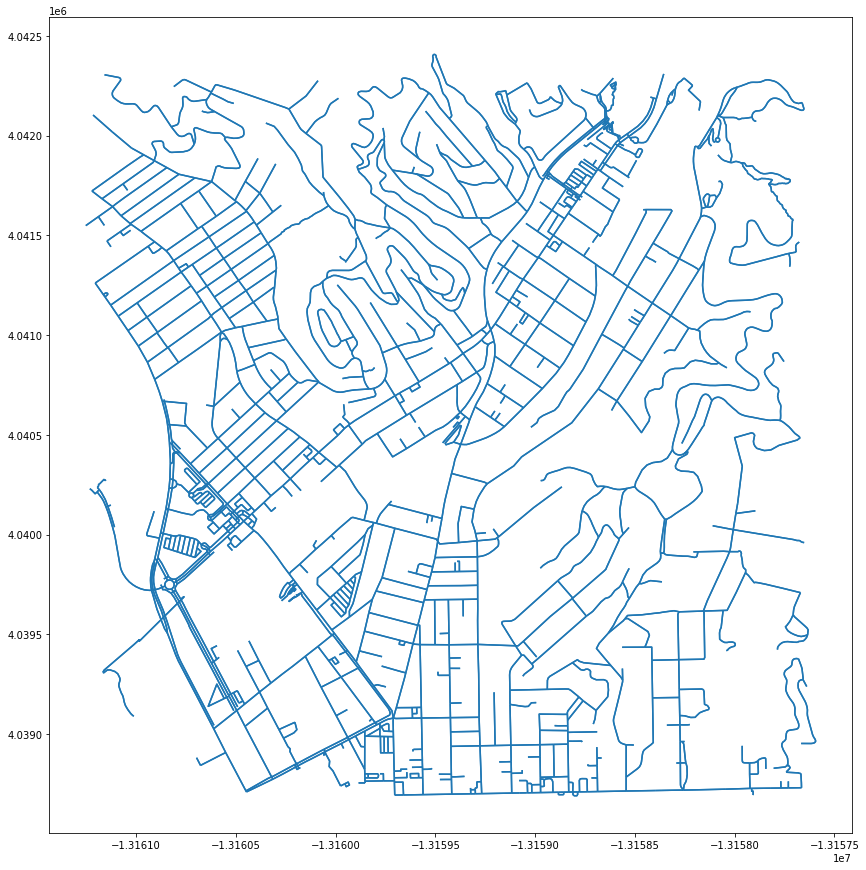

In [132]:
gdf_edges.plot(figsize=(15,15))

In [136]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161252.734988471
4038694.329905593
-13157631.255918141
4042309.5162158757


In [137]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13159441.995453306
4040501.9230607343


In [138]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 1995905139


In [139]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995905139,4.040537e+06,-1.315941e+07,NaN,1,-118.213003,34.087353,POINT (-13159411.288 4040537.413)


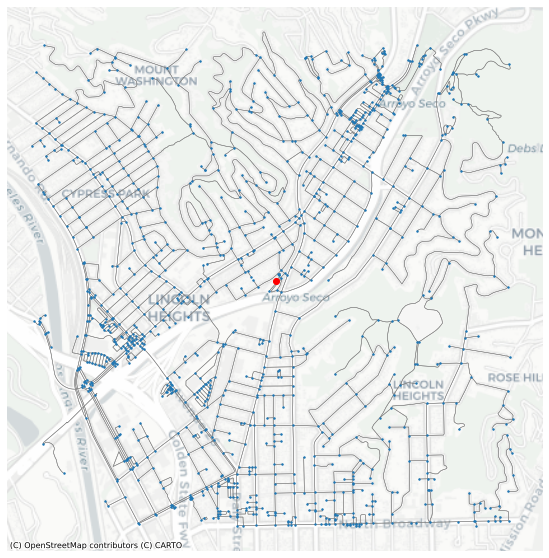

In [141]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [142]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction
u,v,key,,,,,,,,,,,,,,
1669445479,1874531420,0,154405569,NaN,Glenalbyn Drive,residential,False,88.864,"LINESTRING (-13159408.483 4041123.593, -131594...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3455133754,21650945,0,338435900,NaN,North Altura Street,residential,False,31.802,"LINESTRING (-13158505.515 4038945.256, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1669509932,1873968976,0,154413623,NaN,Isabel Street,residential,False,52.816,"LINESTRING (-13161120.109 4042018.872, -131611...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6726870039,6731917703,0,3784001,NaN,Johnston Street,tertiary,False,6.751,"LINESTRING (-13159119.397 4038803.363, -131591...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
7082081808,7082081807,0,758335362,NaN,NaN,service,False,9.652,"LINESTRING (-13160509.410 4040117.713, -131605...",customers,NaN,NaN,NaN,NaN,NaN,NaN


In [143]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [144]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction,walk_time
u,v,key,,,,,,,,,,,,,,,
6789908769,6433927349,0,"[185887376, 185887377]","[2, 3]",Pasadena Avenue,secondary,False,149.756,"LINESTRING (-13159696.288 4039132.524, -131596...",NaN,NaN,35 mph,NaN,NaN,NaN,NaN,1.871950
1613467351,1614226394,0,154410754,NaN,Isabel Street,residential,False,92.630,"LINESTRING (-13160289.621 4041081.103, -131602...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.157875
279072671,279072662,0,13467521,NaN,West Avenue 33,residential,False,12.731,"LINESTRING (-13159795.719 4040057.000, -131598...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.159137
6787624912,6872663718,0,723712625,NaN,NaN,service,False,10.843,"LINESTRING (-13160534.246 4039190.261, -131605...",customers,NaN,NaN,NaN,NaN,NaN,NaN,0.135538
6726061378,279072885,0,13467542,NaN,West Avenue 34,residential,False,39.558,"LINESTRING (-13159513.858 4040093.318, -131594...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.494475


In [145]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [146]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [148]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 1995905139, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 142 nodes within 10 minutes 


In [149]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6933605916,4.040230e+06,-1.316123e+07,NaN,1,-118.229364,34.085067,POINT (-13161232.586 4040230.187),NaN,NaN
7528072413,4.041995e+06,-1.315859e+07,NaN,3,-118.205582,34.098193,POINT (-13158585.164 4041994.607),NaN,NaN
18453033,4.039674e+06,-1.315944e+07,NaN,3,-118.213219,34.080933,POINT (-13159435.378 4039674.467),NaN,NaN
5549335045,4.040245e+06,-1.316064e+07,NaN,4,-118.224085,34.085178,POINT (-13160644.919 4040245.066),NaN,NaN
5555657485,4.041883e+06,-1.315876e+07,NaN,1,-118.207127,34.097359,POINT (-13158757.164 4041882.505),NaN,NaN
602721638,4.042048e+06,-1.315863e+07,NaN,3,-118.205980,34.098588,POINT (-13158629.547 4042047.680),NaN,NaN
7256925379,4.040029e+06,-1.316058e+07,NaN,3,-118.223525,34.083570,POINT (-13160582.658 4040028.976),NaN,NaN
1978948942,4.040662e+06,-1.315994e+07,NaN,1,-118.217720,34.088279,POINT (-13159936.404 4040661.948),NaN,NaN
6789908779,4.038809e+06,-1.315964e+07,NaN,1,-118.215090,34.074495,POINT (-13159643.634 4038809.330),NaN,NaN


In [150]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [151]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
364612181,4.040969e+06,-1.315921e+07,NaN,3,-118.211163,34.090563,POINT (-13159206.460 4040968.876),10 mins,#0d0887
18453032,4.039083e+06,-1.315943e+07,NaN,4,-118.213126,34.076529,POINT (-13159425.014 4039082.636),NaN,#cccccc
364612090,4.041329e+06,-1.315924e+07,NaN,3,-118.211478,34.093245,POINT (-13159241.548 4041329.380),10 mins,#0d0887
2256041709,4.039914e+06,-1.315818e+07,NaN,3,-118.201979,34.082715,POINT (-13158184.158 4039914.072),NaN,#cccccc
7495693870,4.040207e+06,-1.316049e+07,NaN,3,-118.222655,34.084894,POINT (-13160485.799 4040206.934),NaN,#cccccc


<AxesSubplot:>

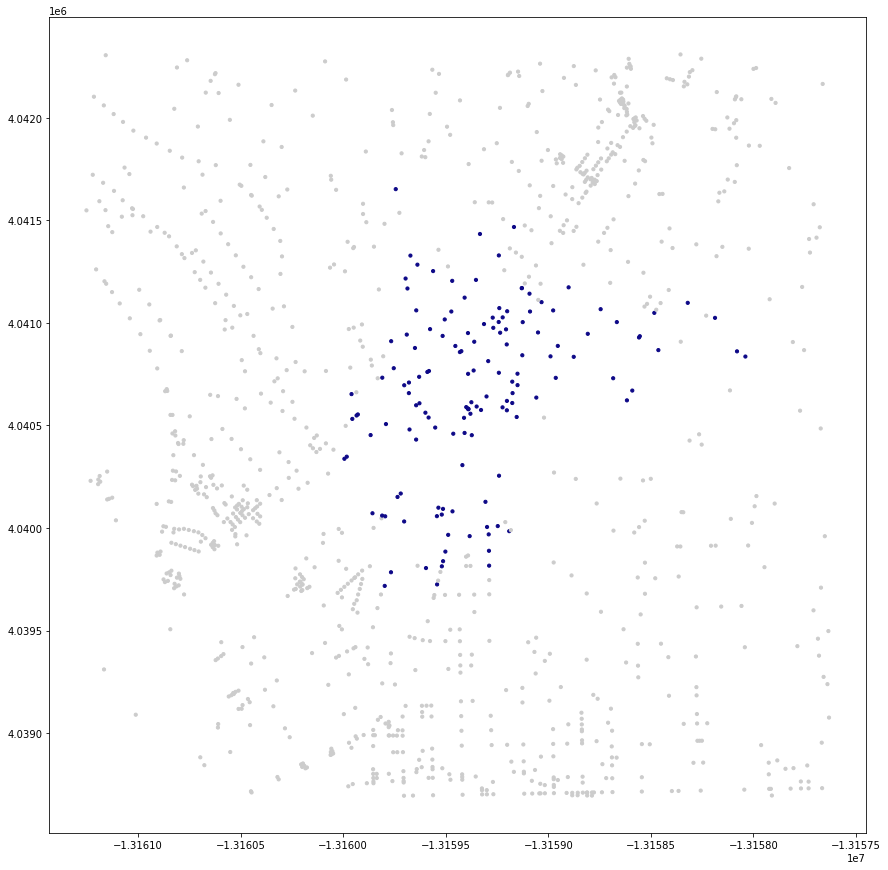

In [152]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

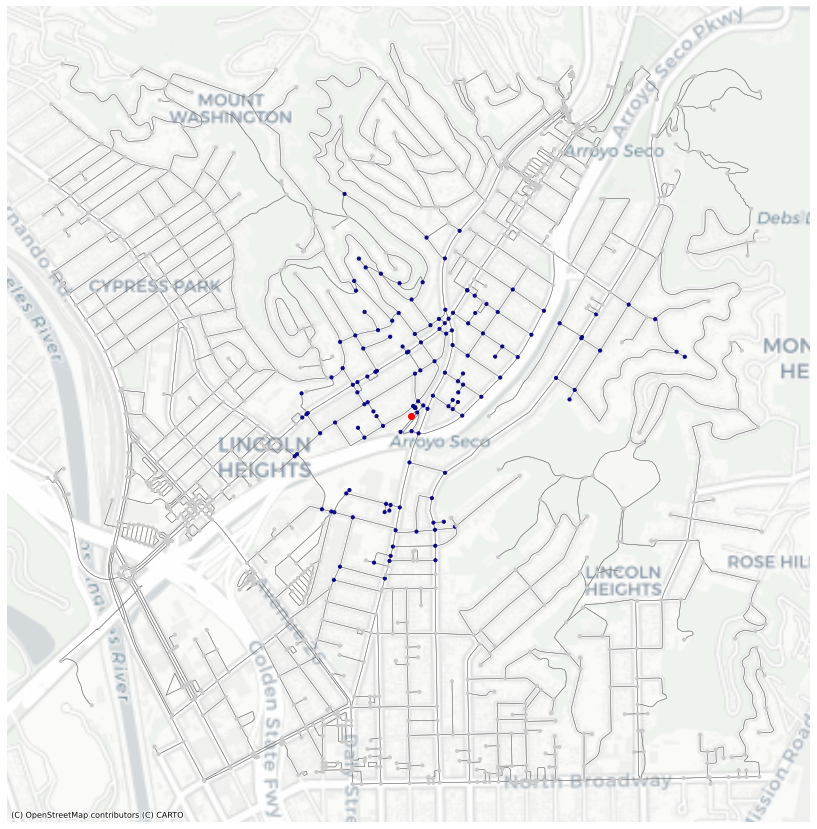

In [154]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [155]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
14965940,4.040909e+06,-1.315936e+07,NaN,4,-118.212555,34.090114,POINT (-13159361.484 4040908.522),10 mins,#0d0887
1669488556,4.040951e+06,-1.315939e+07,NaN,3,-118.212831,34.090428,POINT (-13159392.130 4040950.824),10 mins,#0d0887
18361081,4.040814e+06,-1.315929e+07,NaN,4,-118.211944,34.089410,POINT (-13159293.389 4040813.959),10 mins,#0d0887
27292003,4.040862e+06,-1.315942e+07,NaN,3,-118.213120,34.089771,POINT (-13159424.323 4040862.484),10 mins,#0d0887
7497608094,4.040976e+06,-1.315927e+07,NaN,3,-118.211721,34.090619,POINT (-13159268.554 4040976.390),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7428386997,4.040562e+06,-1.315960e+07,NaN,1,-118.214695,34.087539,POINT (-13159599.618 4040562.454),10 mins,#0d0887
7874387046,4.040620e+06,-1.315920e+07,NaN,1,-118.211124,34.087967,POINT (-13159202.119 4040619.930),10 mins,#0d0887
8880638493,4.040737e+06,-1.315963e+07,NaN,3,-118.214969,34.088841,POINT (-13159630.198 4040737.422),10 mins,#0d0887


In [156]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

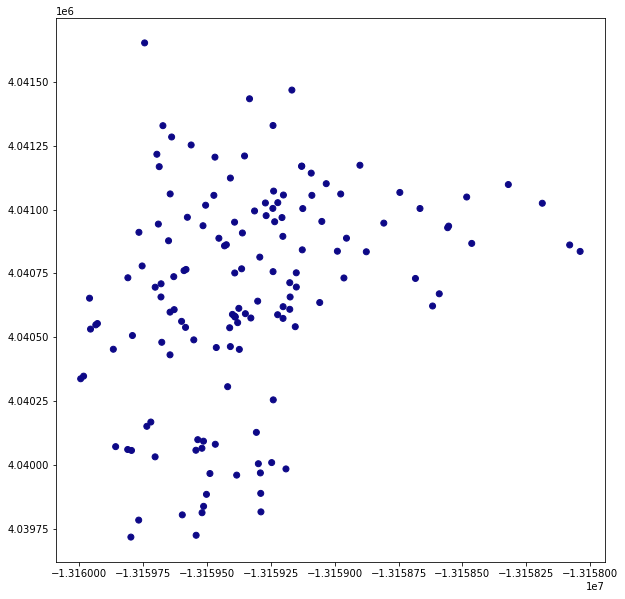

In [157]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

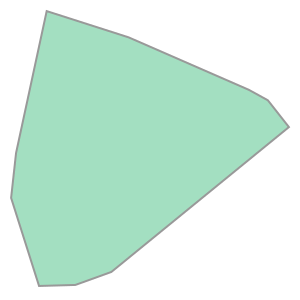

In [158]:
gdf_10.unary_union.convex_hull

In [159]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13159994.736 4040337.648, -131599...",4.040909e+06,-1.315936e+07,traffic_signals,4,-118.212555,34.090114,#0d0887


In [160]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


In [161]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


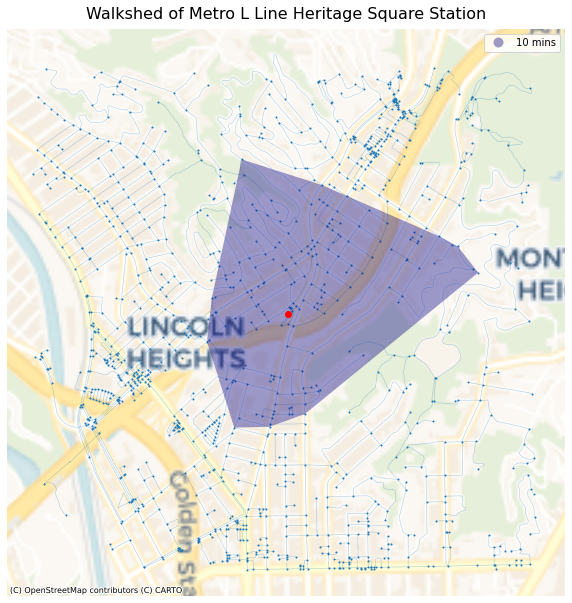

In [164]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Highland Park Station

In [124]:
address = 'Heritage Square, Marmion Way, Dayton Avenue, Los Angeles, Los Angeles County, California, 90031-2212, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [125]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.45 s, sys: 35.9 ms, total: 3.49 s
Wall time: 11.1 s


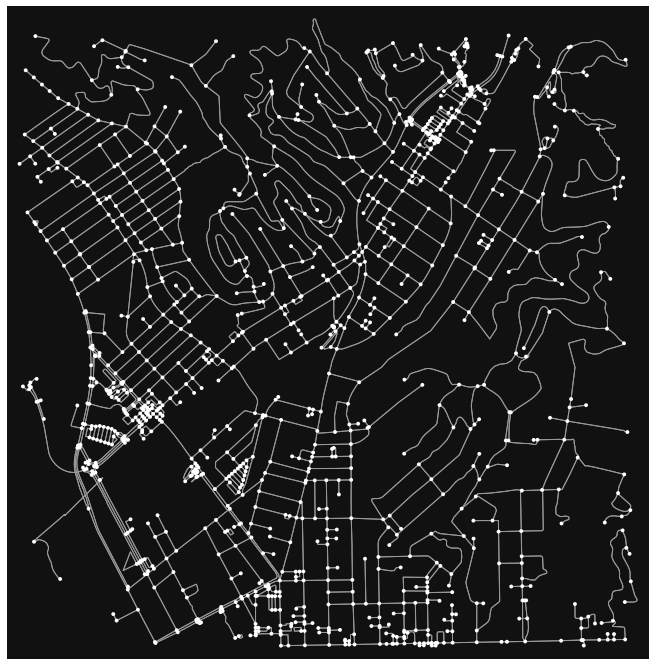

In [126]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [127]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [128]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [129]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10559930,4.040461e+06,-1.316083e+07,traffic_signals,3,-118.225778,34.086785,POINT (-13160833.383 4040461.066)
6872663520,4.040451e+06,-1.316082e+07,NaN,4,-118.225648,34.086711,POINT (-13160818.979 4040451.213)
2156883458,4.040355e+06,-1.316083e+07,NaN,3,-118.225738,34.085997,POINT (-13160828.975 4040355.176)
18660349,4.040552e+06,-1.316084e+07,NaN,3,-118.225864,34.087459,POINT (-13160843.001 4040551.674)
14695503,4.040667e+06,-1.316087e+07,NaN,3,-118.226097,34.088318,POINT (-13160868.883 4040667.177)


### Plotting the station area

<AxesSubplot:>

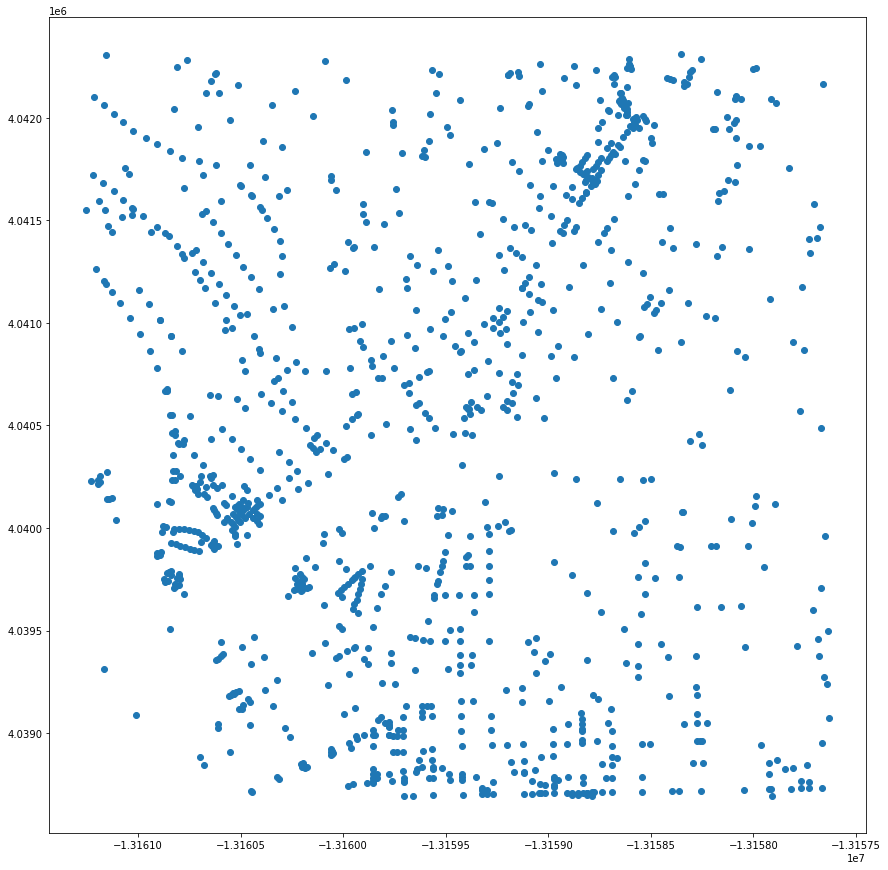

In [130]:
gdf_nodes.plot(figsize=(15,15))

In [131]:
gdf_edges.head()

osmid lanes               name    highway  \
u          v          key                                                  
10559930   6872663520 0    398375445     5     West Avenue 26    primary   
           2156883458 0    104359364   NaN  San Fernando Road  secondary   
           18660349   0    398374225     5  San Fernando Road    primary   
6872663520 10559930   0    398375445     5     West Avenue 26    primary   
           2156883447 0    398375445     5     West Avenue 26    primary   

                           oneway  length  \
u          v          key                   
10559930   6872663520 0     False  14.437   
           2156883458 0     False  87.691   
           18660349   0     False  75.390   
6872663520 10559930   0     False  14.437   
           2156883447 0     False  46.393   

                                                                    geometry  \
u          v          key                                                      
10559930   6872663520 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           2156883458 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           18660349   0    LINESTRING (-13160833.383 4040461.066, -131608...   
6872663520 10559930   0    LINESTRING (-13160818.979 4040451.213, -131608...   
           2156883447 0    LINESTRING (-13160818.979 4040451.213, -131607...   

                          access service maxspeed bridge width tunnel junction  
u          v          key                                                       
10559930   6872663520 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883458 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           18660349   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
6872663520 10559930   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883447 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN

<AxesSubplot:>

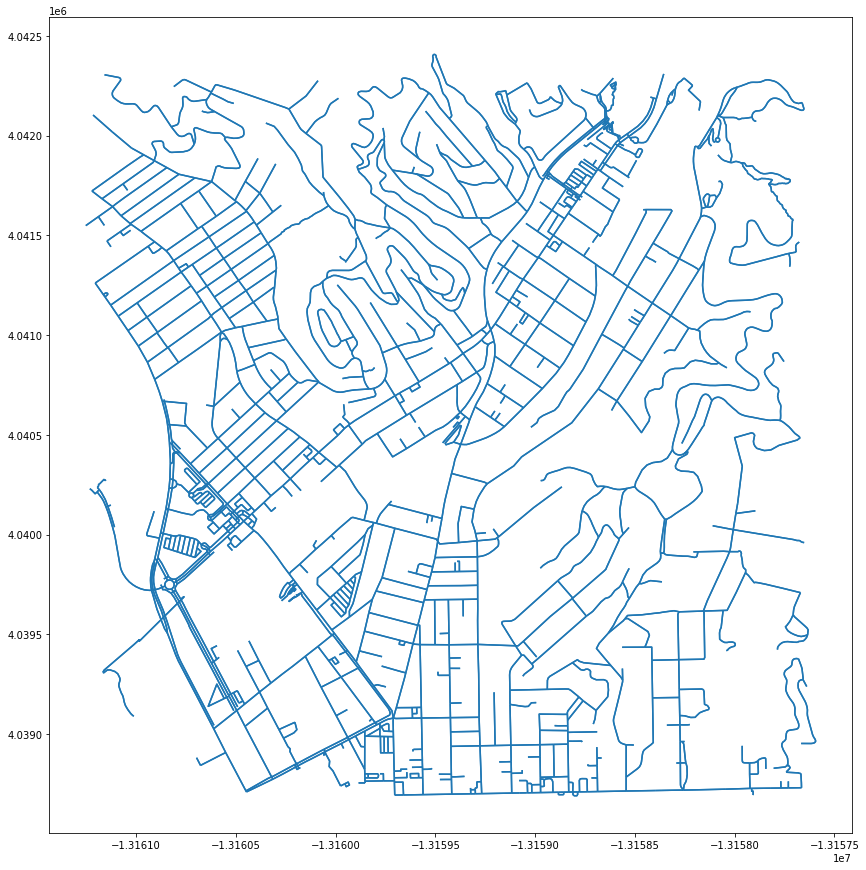

In [132]:
gdf_edges.plot(figsize=(15,15))

In [136]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161252.734988471
4038694.329905593
-13157631.255918141
4042309.5162158757


In [137]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13159441.995453306
4040501.9230607343


In [138]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 1995905139


In [139]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995905139,4.040537e+06,-1.315941e+07,NaN,1,-118.213003,34.087353,POINT (-13159411.288 4040537.413)


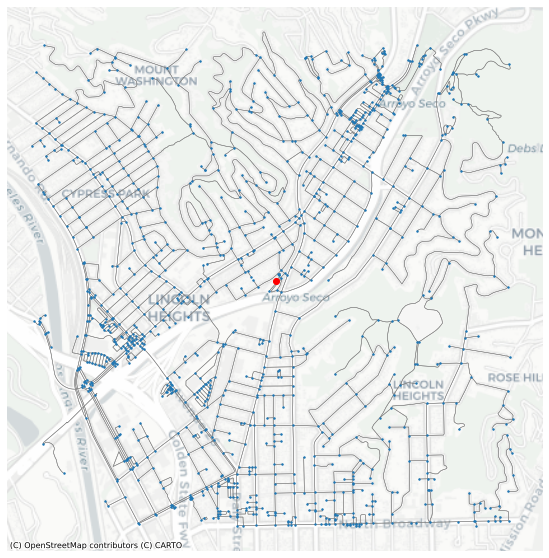

In [141]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [142]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction
u,v,key,,,,,,,,,,,,,,
1669445479,1874531420,0,154405569,NaN,Glenalbyn Drive,residential,False,88.864,"LINESTRING (-13159408.483 4041123.593, -131594...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
3455133754,21650945,0,338435900,NaN,North Altura Street,residential,False,31.802,"LINESTRING (-13158505.515 4038945.256, -131585...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1669509932,1873968976,0,154413623,NaN,Isabel Street,residential,False,52.816,"LINESTRING (-13161120.109 4042018.872, -131611...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6726870039,6731917703,0,3784001,NaN,Johnston Street,tertiary,False,6.751,"LINESTRING (-13159119.397 4038803.363, -131591...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
7082081808,7082081807,0,758335362,NaN,NaN,service,False,9.652,"LINESTRING (-13160509.410 4040117.713, -131605...",customers,NaN,NaN,NaN,NaN,NaN,NaN


In [143]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [144]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction,walk_time
u,v,key,,,,,,,,,,,,,,,
6789908769,6433927349,0,"[185887376, 185887377]","[2, 3]",Pasadena Avenue,secondary,False,149.756,"LINESTRING (-13159696.288 4039132.524, -131596...",NaN,NaN,35 mph,NaN,NaN,NaN,NaN,1.871950
1613467351,1614226394,0,154410754,NaN,Isabel Street,residential,False,92.630,"LINESTRING (-13160289.621 4041081.103, -131602...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.157875
279072671,279072662,0,13467521,NaN,West Avenue 33,residential,False,12.731,"LINESTRING (-13159795.719 4040057.000, -131598...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.159137
6787624912,6872663718,0,723712625,NaN,NaN,service,False,10.843,"LINESTRING (-13160534.246 4039190.261, -131605...",customers,NaN,NaN,NaN,NaN,NaN,NaN,0.135538
6726061378,279072885,0,13467542,NaN,West Avenue 34,residential,False,39.558,"LINESTRING (-13159513.858 4040093.318, -131594...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.494475


In [145]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [146]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [148]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 1995905139, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 142 nodes within 10 minutes 


In [149]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6933605916,4.040230e+06,-1.316123e+07,NaN,1,-118.229364,34.085067,POINT (-13161232.586 4040230.187),NaN,NaN
7528072413,4.041995e+06,-1.315859e+07,NaN,3,-118.205582,34.098193,POINT (-13158585.164 4041994.607),NaN,NaN
18453033,4.039674e+06,-1.315944e+07,NaN,3,-118.213219,34.080933,POINT (-13159435.378 4039674.467),NaN,NaN
5549335045,4.040245e+06,-1.316064e+07,NaN,4,-118.224085,34.085178,POINT (-13160644.919 4040245.066),NaN,NaN
5555657485,4.041883e+06,-1.315876e+07,NaN,1,-118.207127,34.097359,POINT (-13158757.164 4041882.505),NaN,NaN
602721638,4.042048e+06,-1.315863e+07,NaN,3,-118.205980,34.098588,POINT (-13158629.547 4042047.680),NaN,NaN
7256925379,4.040029e+06,-1.316058e+07,NaN,3,-118.223525,34.083570,POINT (-13160582.658 4040028.976),NaN,NaN
1978948942,4.040662e+06,-1.315994e+07,NaN,1,-118.217720,34.088279,POINT (-13159936.404 4040661.948),NaN,NaN
6789908779,4.038809e+06,-1.315964e+07,NaN,1,-118.215090,34.074495,POINT (-13159643.634 4038809.330),NaN,NaN


In [150]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [151]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
364612181,4.040969e+06,-1.315921e+07,NaN,3,-118.211163,34.090563,POINT (-13159206.460 4040968.876),10 mins,#0d0887
18453032,4.039083e+06,-1.315943e+07,NaN,4,-118.213126,34.076529,POINT (-13159425.014 4039082.636),NaN,#cccccc
364612090,4.041329e+06,-1.315924e+07,NaN,3,-118.211478,34.093245,POINT (-13159241.548 4041329.380),10 mins,#0d0887
2256041709,4.039914e+06,-1.315818e+07,NaN,3,-118.201979,34.082715,POINT (-13158184.158 4039914.072),NaN,#cccccc
7495693870,4.040207e+06,-1.316049e+07,NaN,3,-118.222655,34.084894,POINT (-13160485.799 4040206.934),NaN,#cccccc


<AxesSubplot:>

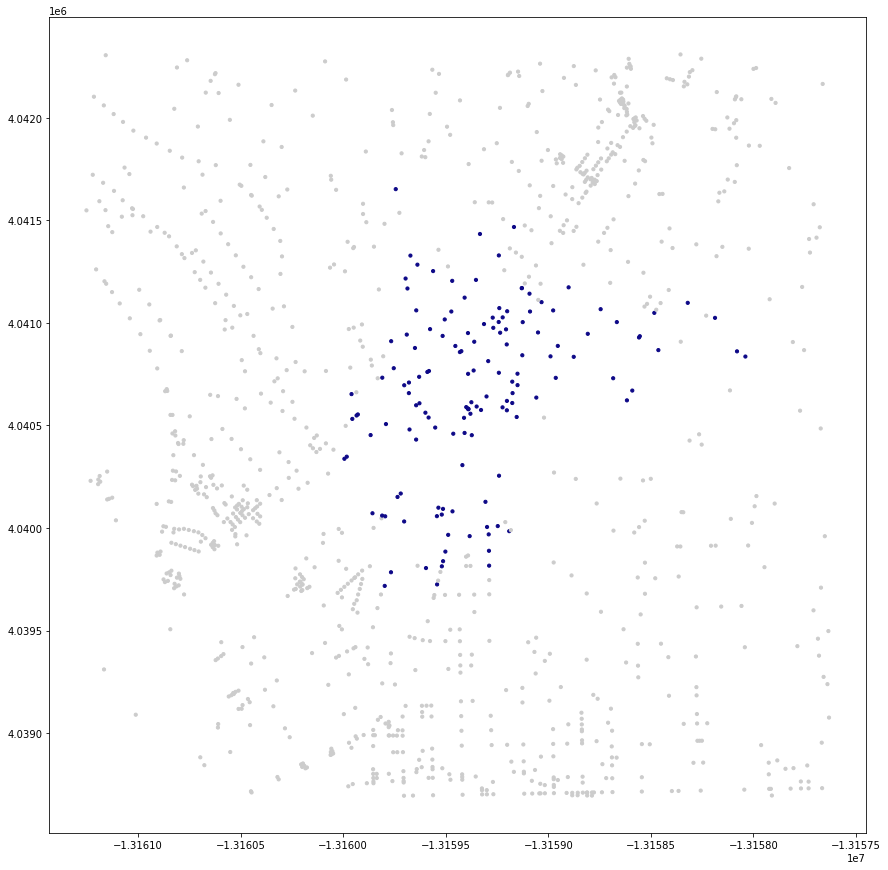

In [152]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

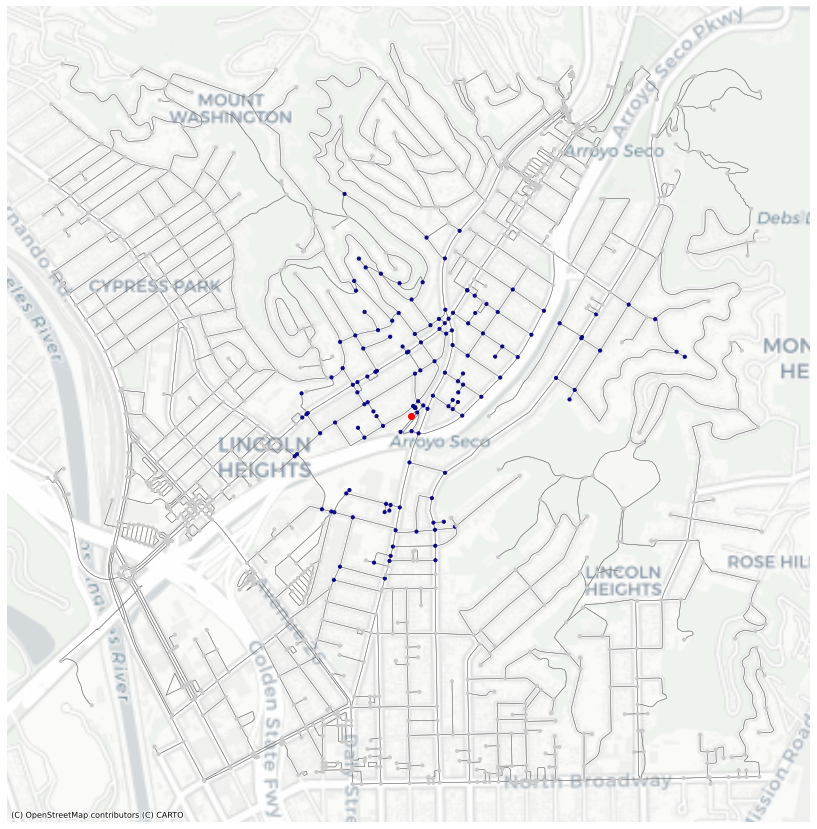

In [154]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [155]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
14965940,4.040909e+06,-1.315936e+07,NaN,4,-118.212555,34.090114,POINT (-13159361.484 4040908.522),10 mins,#0d0887
1669488556,4.040951e+06,-1.315939e+07,NaN,3,-118.212831,34.090428,POINT (-13159392.130 4040950.824),10 mins,#0d0887
18361081,4.040814e+06,-1.315929e+07,NaN,4,-118.211944,34.089410,POINT (-13159293.389 4040813.959),10 mins,#0d0887
27292003,4.040862e+06,-1.315942e+07,NaN,3,-118.213120,34.089771,POINT (-13159424.323 4040862.484),10 mins,#0d0887
7497608094,4.040976e+06,-1.315927e+07,NaN,3,-118.211721,34.090619,POINT (-13159268.554 4040976.390),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7428386997,4.040562e+06,-1.315960e+07,NaN,1,-118.214695,34.087539,POINT (-13159599.618 4040562.454),10 mins,#0d0887
7874387046,4.040620e+06,-1.315920e+07,NaN,1,-118.211124,34.087967,POINT (-13159202.119 4040619.930),10 mins,#0d0887
8880638493,4.040737e+06,-1.315963e+07,NaN,3,-118.214969,34.088841,POINT (-13159630.198 4040737.422),10 mins,#0d0887


In [156]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

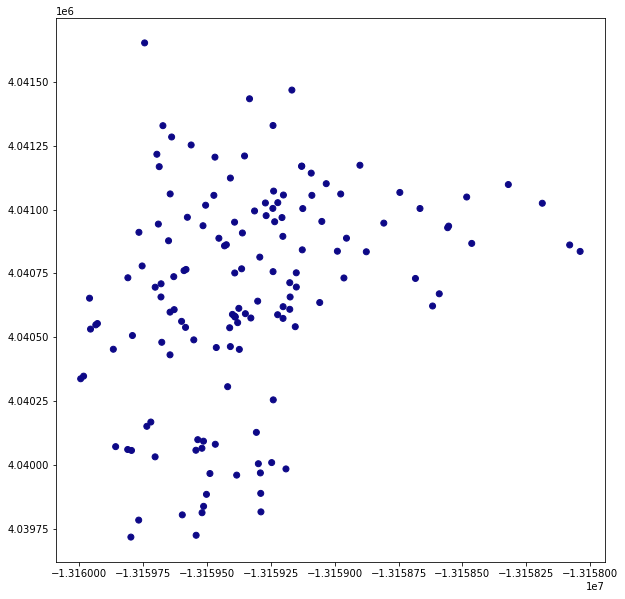

In [157]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

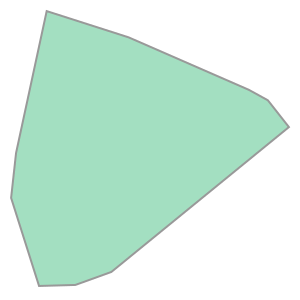

In [158]:
gdf_10.unary_union.convex_hull

In [159]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13159994.736 4040337.648, -131599...",4.040909e+06,-1.315936e+07,traffic_signals,4,-118.212555,34.090114,#0d0887


In [160]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


In [161]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


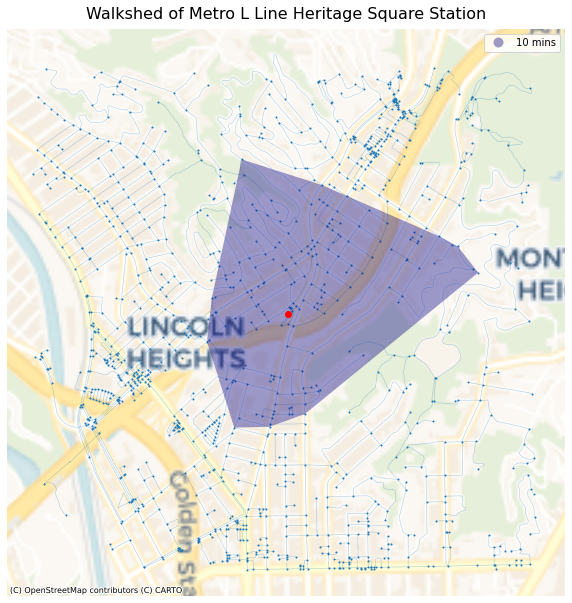

In [164]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Highland Park Station

In [166]:
address = 'Highland Park, Marmion Way, Highland Park, Los Angeles, Los Angeles County, California, 90042, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [167]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.23 s, sys: 34.3 ms, total: 3.26 s
Wall time: 13.8 s


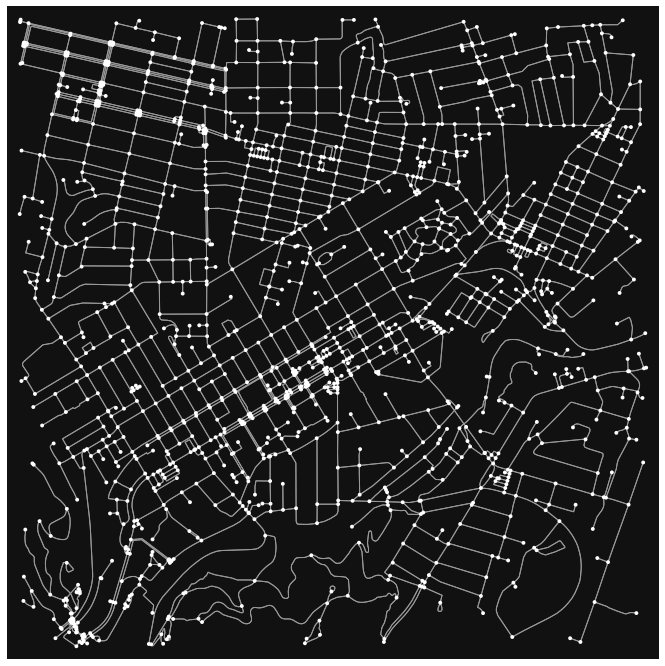

In [168]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [169]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [170]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [171]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10552905,4.045125e+06,-1.315873e+07,traffic_signals,4,-118.206904,34.121476,POINT (-13158732.406 4045124.904)
14956558,4.045007e+06,-1.315876e+07,stop,4,-118.207144,34.120598,POINT (-13158759.123 4045006.963)
6787557826,4.045178e+06,-1.315872e+07,NaN,3,-118.206794,34.121869,POINT (-13158720.061 4045177.844)
3644839500,4.045123e+06,-1.315872e+07,NaN,4,-118.206818,34.121461,POINT (-13158722.799 4045123.008)
10552907,4.044845e+06,-1.315760e+07,traffic_signals,4,-118.196712,34.119394,POINT (-13157597.793 4044844.985)


### Plotting the station area

<AxesSubplot:>

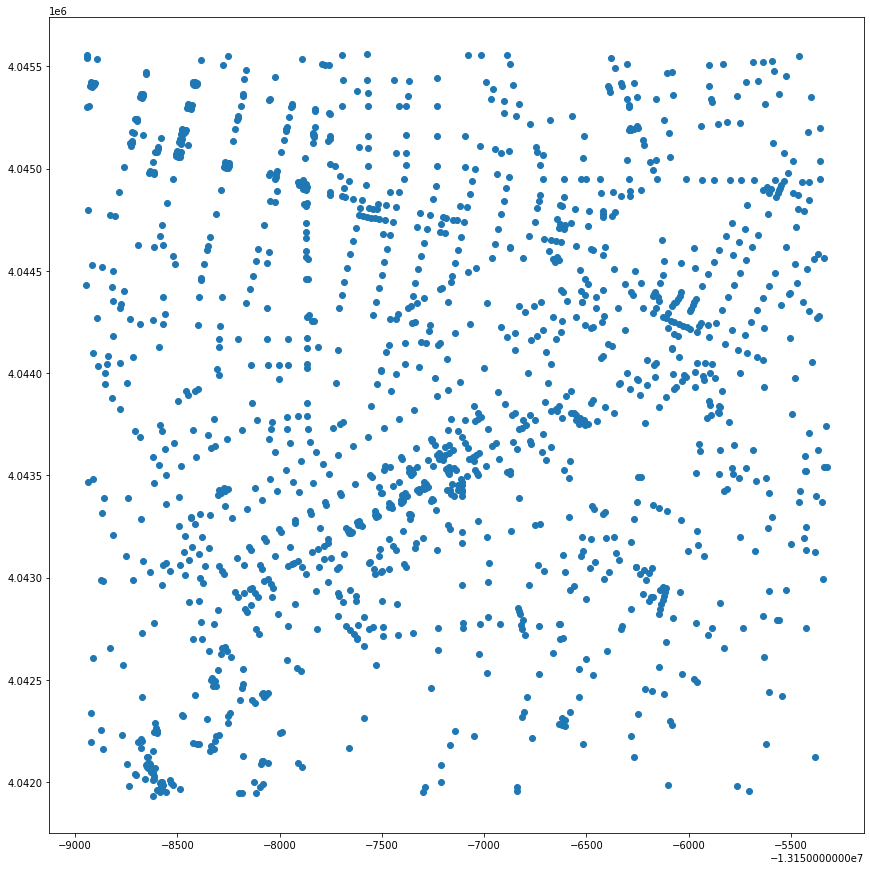

In [172]:
gdf_nodes.plot(figsize=(15,15))

In [173]:
gdf_edges.head()

osmid lanes            name    highway  oneway  \
u        v          key                                                       
10552905 14956558   0     54674043     2       Avenue 50   tertiary   False   
         6787557826 0     54674043     2       Avenue 50   tertiary   False   
         3644839500 0    398616334     5  York Boulevard  secondary   False   
14956558 10553872   0     54674043     2       Avenue 50   tertiary   False   
         10552905   0     54674043     2       Avenue 50   tertiary   False   

                          length  \
u        v          key            
10552905 14956558   0    100.000   
         6787557826 0     44.952   
         3644839500 0      8.097   
14956558 10553872   0    101.501   
         10552905   0    100.000   

                                                                  geometry  \
u        v          key                                                      
10552905 14956558   0    LINESTRING (-13158732.406 4045124.904, -131587...   
         6787557826 0    LINESTRING (-13158732.406 4045124.904, -131587...   
         3644839500 0    LINESTRING (-13158732.406 4045124.904, -131587...   
14956558 10553872   0    LINESTRING (-13158759.123 4045006.963, -131587...   
         10552905   0    LINESTRING (-13158759.123 4045006.963, -131587...   

                        service access bridge maxspeed junction width tunnel  
u        v          key                                                       
10552905 14956558   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         6787557826 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         3644839500 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
14956558 10553872   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         10552905   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN

<AxesSubplot:>

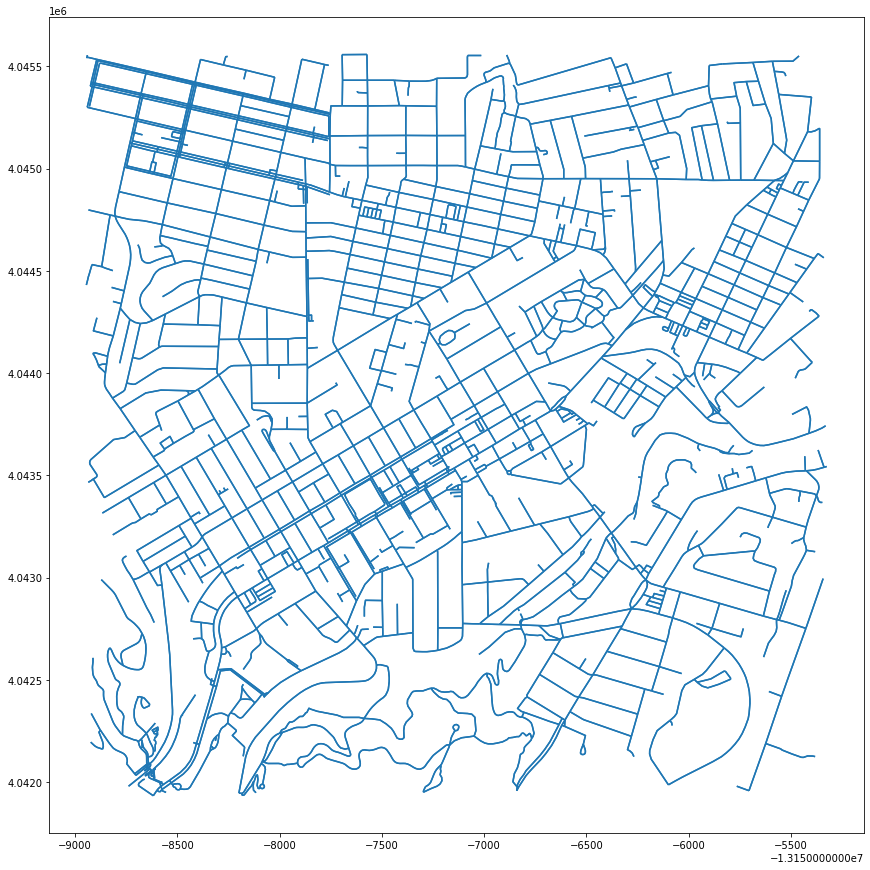

In [174]:
gdf_edges.plot(figsize=(15,15))

In [175]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13158945.382506957
4041933.3467410295
-13155325.361721948
4045557.8058276335


In [176]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13157135.372114453
4043745.5762843313


In [177]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 111964509


In [178]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
111964509,4.043716e+06,-1.315713e+07,NaN,3,-118.192502,34.110999,POINT (-13157129.183 4043716.222)


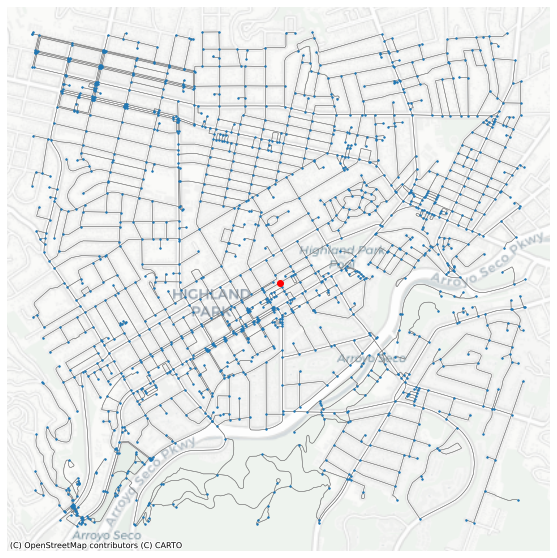

In [179]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [180]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel
u,v,key,,,,,,,,,,,,,,
138387223,123164321,0,4388666,2,South Avenue 60,tertiary,False,184.134,"LINESTRING (-13155635.175 4042811.910, -131558...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
21477001,21477000,0,167008806,NaN,Avenue 52,residential,False,114.050,"LINESTRING (-13158392.436 4044373.817, -131584...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
6734865599,2863170167,0,282406513,NaN,NaN,footway,False,13.909,"LINESTRING (-13157360.226 4043521.189, -131573...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
8840288112,8840288118,0,955128248,NaN,NaN,service,False,62.299,"LINESTRING (-13156577.728 4043805.189, -131565...",drive-through,NaN,NaN,NaN,NaN,NaN,NaN
2634612699,2634612701,0,911432390,NaN,NaN,footway,False,106.609,"LINESTRING (-13158594.314 4045106.509, -131587...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [181]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [182]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,,
8410829713,8410829714,0,229938919,NaN,NaN,unclassified,False,16.822,"LINESTRING (-13157573.470 4044763.944, -131575...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.210275
19808980,602739661,0,47323311,NaN,NaN,service,False,49.954,"LINESTRING (-13158492.579 4043254.418, -131584...",alley,NaN,NaN,NaN,NaN,NaN,NaN,0.624425
7361921498,7361921490,0,"[398614809, 398614811, 398614807]","[6, 5]",York Boulevard,secondary,False,31.200,"LINESTRING (-13157187.202 4044758.552, -131571...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.390000
1784125359,1784125418,0,167017172,NaN,Mount Angelus Drive,residential,False,104.211,"LINESTRING (-13156624.204 4044199.505, -131566...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.302638
7528143711,7528143706,0,10535462,NaN,Woodside Drive,service,False,11.401,"LINESTRING (-13158617.012 4042029.895, -131586...",alley,NaN,NaN,NaN,NaN,NaN,NaN,0.142512


In [183]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [184]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [186]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 111964509, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 240 nodes within 10 minutes 


In [187]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
580299867,4.043438e+06,-1.315812e+07,NaN,3,-118.201397,34.108928,POINT (-13158119.381 4043437.817),NaN,NaN
6731835028,4.044242e+06,-1.315735e+07,NaN,1,-118.194516,34.114913,POINT (-13157353.369 4044242.491),NaN,NaN
1669570900,4.043945e+06,-1.315886e+07,NaN,3,-118.208016,34.112699,POINT (-13158856.204 4043944.806),NaN,NaN
20939321,4.043500e+06,-1.315856e+07,NaN,4,-118.205320,34.109393,POINT (-13158556.020 4043500.349),NaN,NaN
6787735558,4.042995e+06,-1.315806e+07,traffic_signals,4,-118.200856,34.105632,POINT (-13158059.101 4042994.698),NaN,NaN
580312099,4.044877e+06,-1.315707e+07,NaN,4,-118.191979,34.119632,POINT (-13157070.907 4044876.988),NaN,NaN
8410740757,4.043020e+06,-1.315620e+07,NaN,3,-118.184113,34.105824,POINT (-13156195.257 4043020.497),NaN,NaN
19809058,4.044885e+06,-1.315776e+07,NaN,3,-118.198137,34.119692,POINT (-13157756.401 4044885.123),NaN,NaN
7245080018,4.044967e+06,-1.315805e+07,NaN,3,-118.200798,34.120301,POINT (-13158052.667 4044967.026),NaN,NaN


In [188]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [189]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
122898964,4.042880e+06,-1.315844e+07,NaN,1,-118.204322,34.104778,POINT (-13158444.957 4042879.844),NaN,#cccccc
1840753877,4.044780e+06,-1.315831e+07,NaN,4,-118.203128,34.118910,POINT (-13158312.064 4044779.931),NaN,#cccccc
123312239,4.045512e+06,-1.315583e+07,NaN,3,-118.180874,34.124351,POINT (-13155834.760 4045511.587),NaN,#cccccc
20827691,4.042428e+06,-1.315807e+07,NaN,4,-118.200967,34.101420,POINT (-13158071.469 4042428.398),NaN,#cccccc
7409758033,4.043953e+06,-1.315773e+07,NaN,1,-118.197862,34.112758,POINT (-13157725.844 4043952.779),10 mins,#0d0887


<AxesSubplot:>

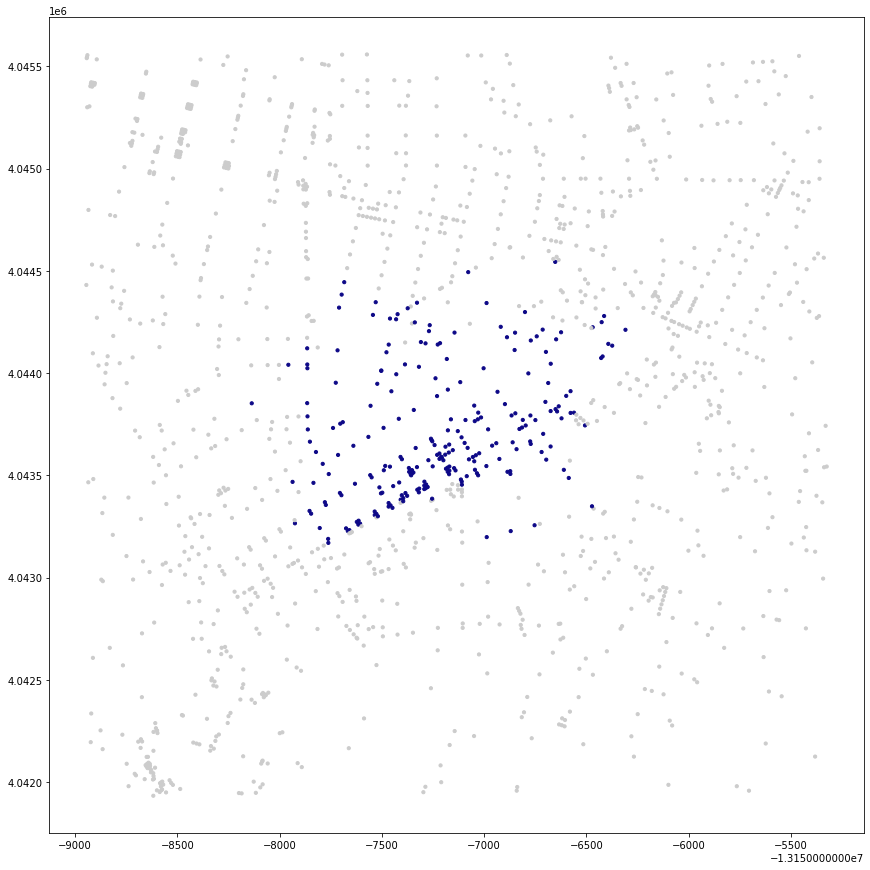

In [190]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

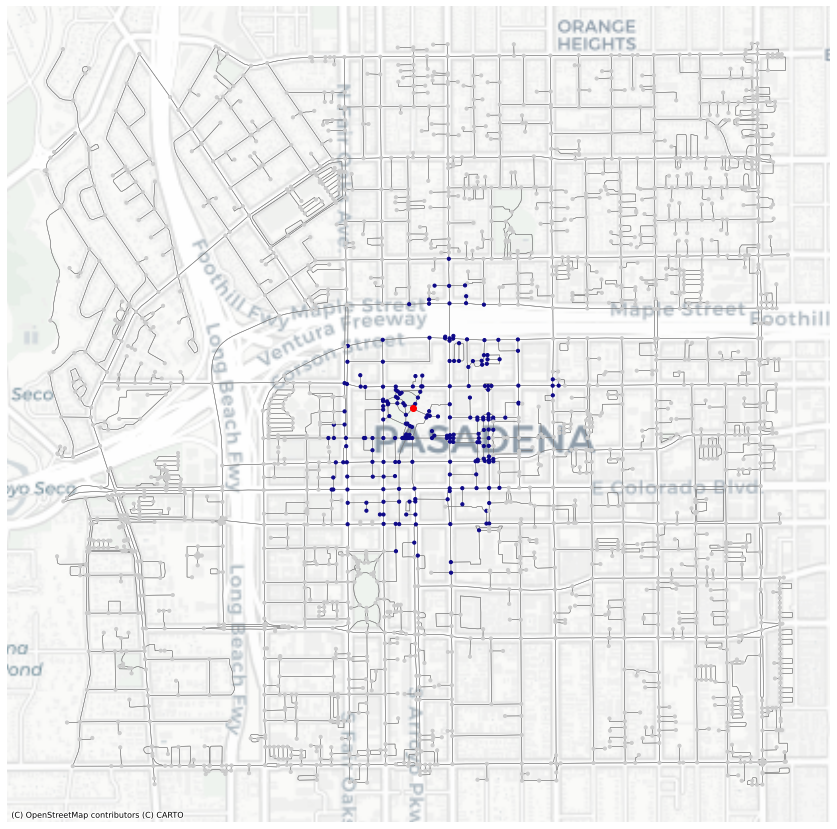

In [235]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot using its center node
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [192]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
18364121,4.044212e+06,-1.315631e+07,NaN,3,-118.185137,34.114683,POINT (-13156309.315 4044211.620),10 mins,#0d0887
19809027,4.043265e+06,-1.315793e+07,NaN,3,-118.199655,34.107645,POINT (-13157925.418 4043265.308),10 mins,#0d0887
14760044,4.043814e+06,-1.315668e+07,traffic_signals,4,-118.188425,34.111728,POINT (-13156675.244 4043814.184),10 mins,#0d0887
702230871,4.043859e+06,-1.315670e+07,NaN,3,-118.188654,34.112062,POINT (-13156700.792 4043859.091),10 mins,#0d0887
6787726293,4.043824e+06,-1.315665e+07,NaN,3,-118.188208,34.111798,POINT (-13156651.143 4043823.650),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8410872932,4.043640e+06,-1.315719e+07,NaN,3,-118.193044,34.110432,POINT (-13157189.440 4043640.029),10 mins,#0d0887
8410872935,4.043651e+06,-1.315717e+07,NaN,3,-118.192880,34.110511,POINT (-13157171.228 4043650.597),10 mins,#0d0887
8459928442,4.043544e+06,-1.315725e+07,NaN,1,-118.193605,34.109716,POINT (-13157251.935 4043543.776),10 mins,#0d0887


In [193]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

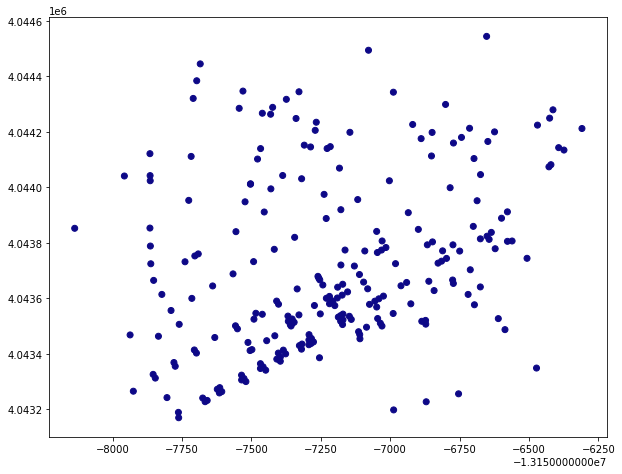

In [194]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

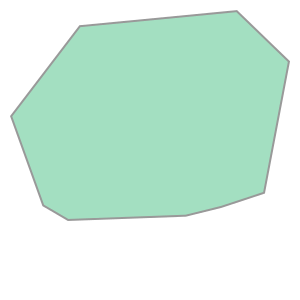

In [195]:
gdf_10.unary_union.convex_hull

In [196]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13158136.669 4043852.127, -131579...",4.044212e+06,-1.315631e+07,traffic_signals,3,-118.185137,34.114683,#0d0887


In [197]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


In [198]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


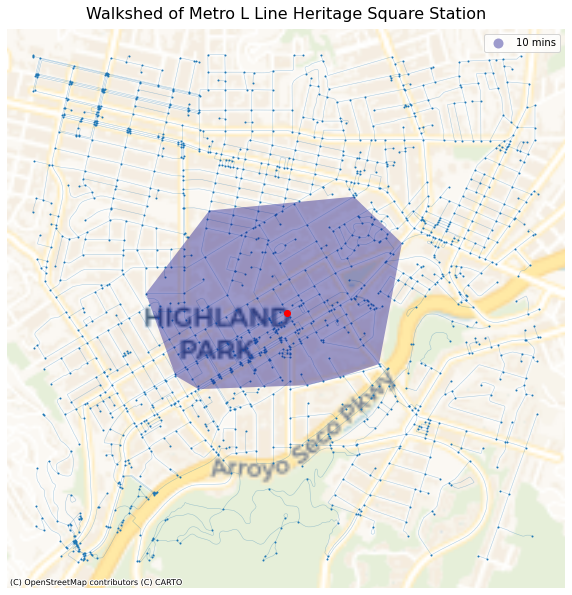

In [199]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Memorial Park Station

In [201]:
address = 'Memorial Park, Holly Street, Old Pasadena, Pasadena, Los Angeles County, California, 91129, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [202]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.87 s, sys: 55.3 ms, total: 3.92 s
Wall time: 9.82 s


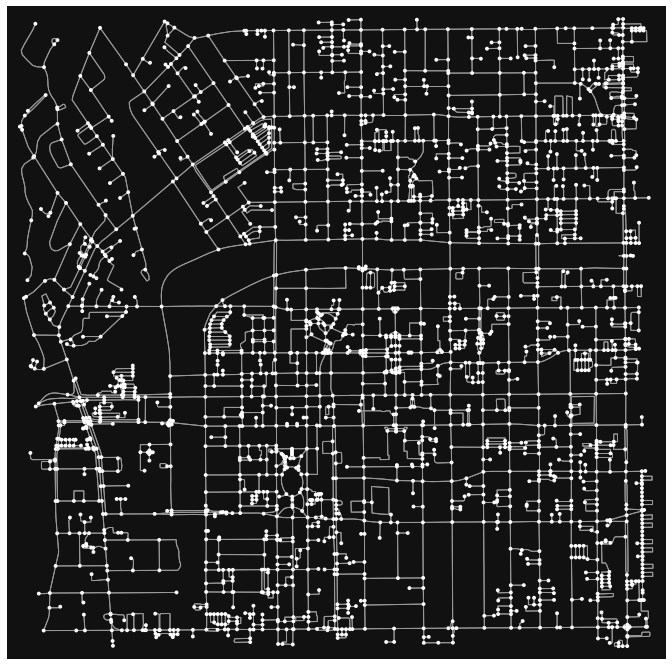

In [203]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [204]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [205]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [206]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14963716,4.049279e+06,-1.315043e+07,traffic_signals,4,-118.132316,34.152361,POINT (-13150429.308 4049278.739)
6784510760,4.049278e+06,-1.315040e+07,NaN,3,-118.132087,34.152358,POINT (-13150403.793 4049278.403)
3892769467,4.049279e+06,-1.315045e+07,traffic_signals,4,-118.132468,34.152362,POINT (-13150446.139 4049278.941)
1995207967,4.049204e+06,-1.315043e+07,NaN,4,-118.132311,34.151805,POINT (-13150428.729 4049204.015)
6784510757,4.049306e+06,-1.315043e+07,NaN,3,-118.132316,34.152564,POINT (-13150429.308 4049306.141)


### Plotting the station area

<AxesSubplot:>

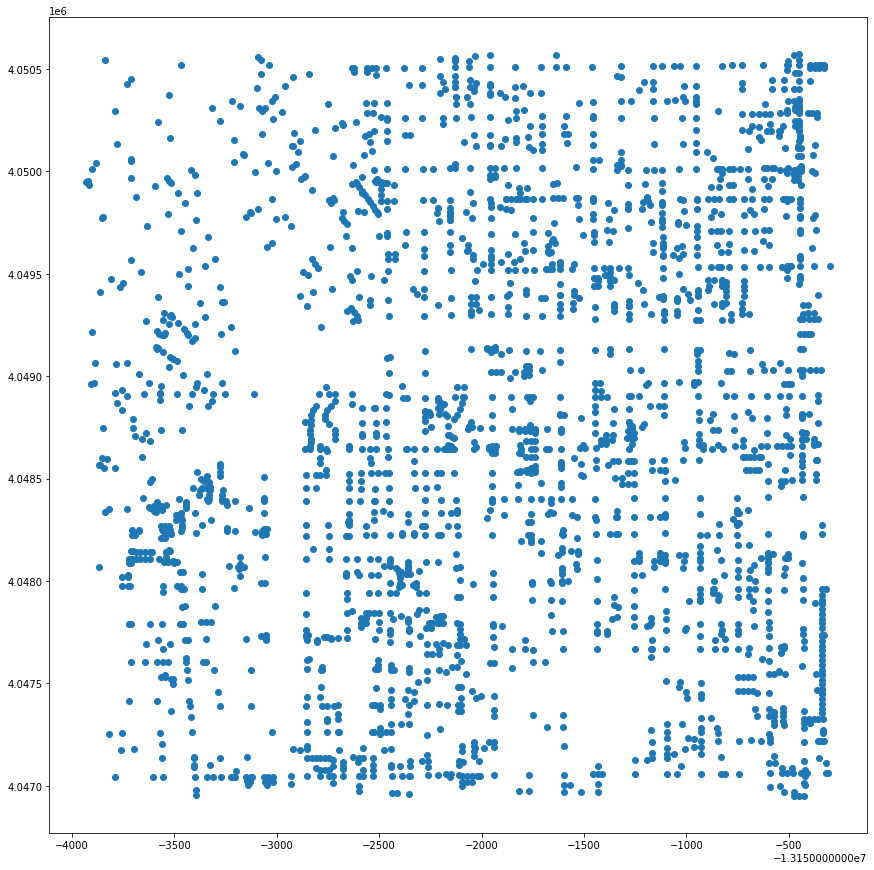

In [207]:
gdf_nodes.plot(figsize=(15,15))

In [208]:
gdf_edges.head()

osmid  oneway               name  \
u          v          key                                                      
14963716   6784510760 0                 405328940   False       Maple Street   
           3892769467 0                 607802969   False       Maple Street   
           1995207967 0    [173415946, 173415947]   False  North Lake Avenue   
           6784510757 0                 385937988   False  North Lake Avenue   
6784510760 14963716   0                 405328940   False       Maple Street   

                             highway  length  \
u          v          key                      
14963716   6784510760 0      primary  21.093   
           3892769467 0      primary  13.914   
           1995207967 0    secondary  61.772   
           6784510757 0    secondary  22.659   
6784510760 14963716   0      primary  21.093   

                                                                    geometry  \
u          v          key                                                      
14963716   6784510760 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           3892769467 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           1995207967 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           6784510757 0    LINESTRING (-13150429.308 4049278.739, -131504...   
6784510760 14963716   0    LINESTRING (-13150403.793 4049278.403, -131504...   

                          maxspeed bridge lanes access service  ref tunnel  \
u          v          key                                                    
14963716   6784510760 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           3892769467 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           1995207967 0     35 mph    yes   NaN    NaN     NaN  NaN    NaN   
           6784510757 0     35 mph    NaN     2    NaN     NaN  NaN    NaN   
6784510760 14963716   0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   

                          width  
u          v          key        
14963716   6784510760 0     NaN  
           3892769467 0     NaN  
           1995207967 0     NaN  
           6784510757 0     NaN  
6784510760 14963716   0     NaN

<AxesSubplot:>

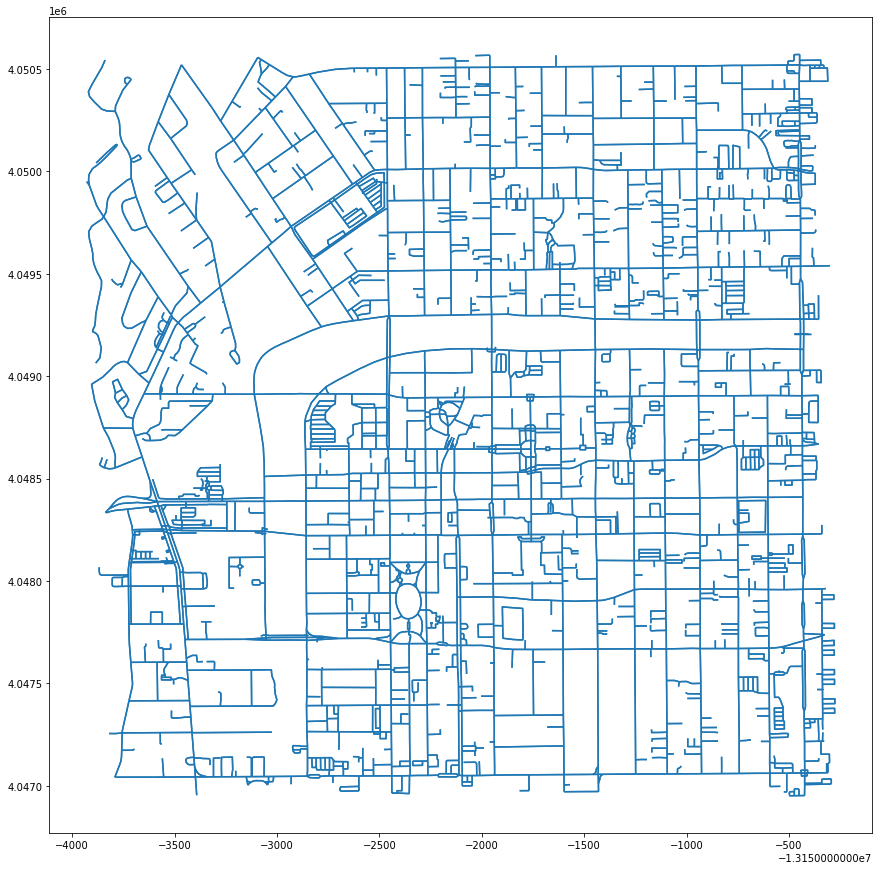

In [209]:
gdf_edges.plot(figsize=(15,15))

In [210]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13153929.226064268
4046951.881736169
-13150300.644810421
4050570.7843818692


In [211]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13152114.935437344
4048761.3330590194


In [212]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 2354954004


In [213]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
2354954004,4.048793e+06,-1.315213e+07,NaN,3,-118.147617,34.148751,POINT (-13152132.619 4048793.142)


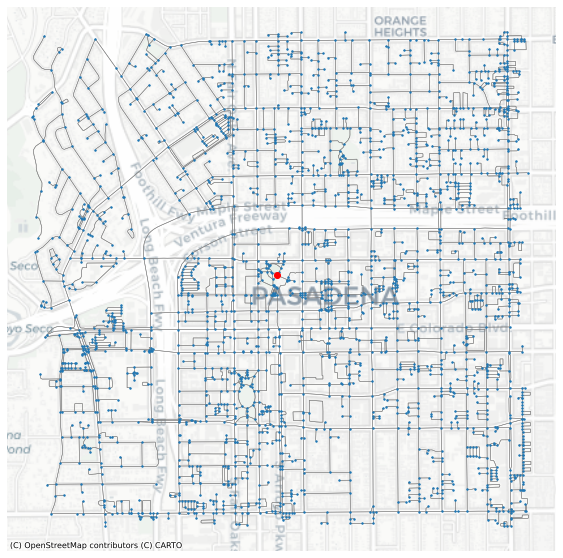

In [214]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [215]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width
u,v,key,,,,,,,,,,,,,,
3053019349,4367212936,0,301189789,False,NaN,footway,98.933,"LINESTRING (-13151934.147 4048625.004, -131519...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3064214867,1927962653,0,405356956,False,South Raymond Avenue,tertiary,43.216,"LINESTRING (-13152267.783 4047642.185, -131522...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1447282182,1447282180,0,131513188,False,NaN,service,53.845,"LINESTRING (-13153277.617 4048511.667, -131533...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,NaN
123632875,1687098872,0,13442890,False,Longwood Lane,residential,47.600,"LINESTRING (-13153351.055 4049538.105, -131533...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7458959721,7458959720,0,797530155,False,NaN,service,45.421,"LINESTRING (-13150637.954 4048604.545, -131506...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [216]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [217]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,,
8460019615,8460019613,0,911106906,False,NaN,service,71.944,"LINESTRING (-13151352.436 4049319.781, -131513...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.899300
6731917828,123580916,0,185913165,False,Lincoln Avenue,secondary,89.620,"LINESTRING (-13152961.581 4049776.424, -131530...",NaN,NaN,2,NaN,NaN,NaN,NaN,NaN,1.120250
1995241175,1995241192,0,188891683,False,NaN,footway,24.723,"LINESTRING (-13152209.952 4047796.926, -131522...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.309037
4584168990,647079467,0,"[560423666, 463106055]",False,NaN,footway,81.634,"LINESTRING (-13152095.137 4048870.177, -131520...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.020425
122782591,122782588,0,13313676,False,North Hudson Avenue,residential,66.596,"LINESTRING (-13150603.634 4048488.962, -131506...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.832450


In [218]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [219]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [221]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 2354954004, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 223 nodes within 10 minutes 


In [222]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
122899898,4.047686e+06,-1.315212e+07,traffic_signals,4,-118.147503,34.140517,POINT (-13152119.928 4047685.614),NaN,NaN
8406800539,4.048158e+06,-1.315274e+07,NaN,3,-118.153104,34.144028,POINT (-13152743.417 4048157.848),NaN,NaN
3053019356,4.048644e+06,-1.315181e+07,crossing,4,-118.144712,34.147640,POINT (-13151809.169 4048643.687),10 mins,#0d0887
6735630479,4.050105e+06,-1.315175e+07,NaN,1,-118.144183,34.158502,POINT (-13151750.314 4050104.934),NaN,NaN
122688534,4.049779e+06,-1.315385e+07,NaN,4,-118.163016,34.156079,POINT (-13153846.794 4049778.899),NaN,NaN
123640401,4.048591e+06,-1.315094e+07,traffic_signals,4,-118.136905,34.147248,POINT (-13150940.142 4048591.054),NaN,NaN
7224999072,4.048610e+06,-1.315043e+07,NaN,3,-118.132367,34.147386,POINT (-13150434.974 4048609.603),NaN,NaN
6726873536,4.048826e+06,-1.315094e+07,NaN,3,-118.136916,34.148996,POINT (-13150941.288 4048826.084),NaN,NaN
122606524,4.050136e+06,-1.315102e+07,NaN,3,-118.137617,34.158733,POINT (-13151019.323 4050135.929),NaN,NaN


In [223]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [224]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6787604515,4.049021e+06,-1.315193e+07,NaN,3,-118.145797,34.150442,POINT (-13151929.984 4049020.671),10 mins,#0d0887
6726417409,4.048738e+06,-1.315077e+07,NaN,3,-118.135358,34.148339,POINT (-13150767.853 4048737.777),NaN,#cccccc
647076745,4.047766e+06,-1.315236e+07,NaN,3,-118.149630,34.141113,POINT (-13152356.616 4047765.789),NaN,#cccccc
5624084227,4.048670e+06,-1.315142e+07,NaN,1,-118.141176,34.147832,POINT (-13151415.587 4048669.581),NaN,#cccccc
6790055300,4.048896e+06,-1.315209e+07,NaN,3,-118.147238,34.149518,POINT (-13152090.395 4048896.353),10 mins,#0d0887


<AxesSubplot:>

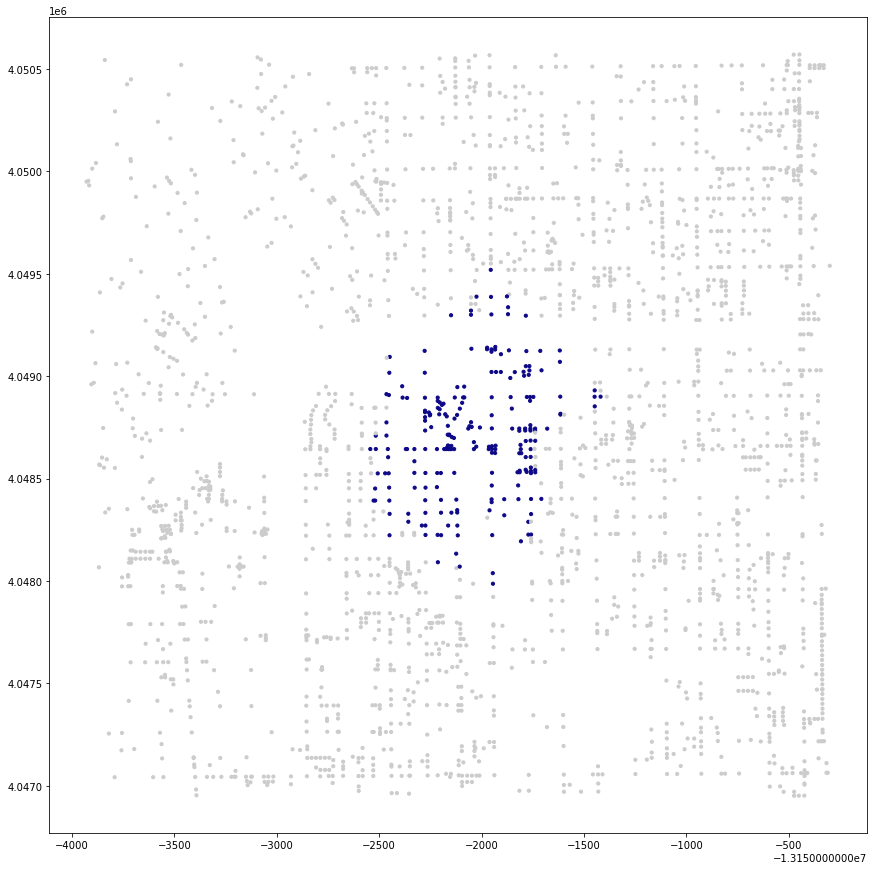

In [225]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

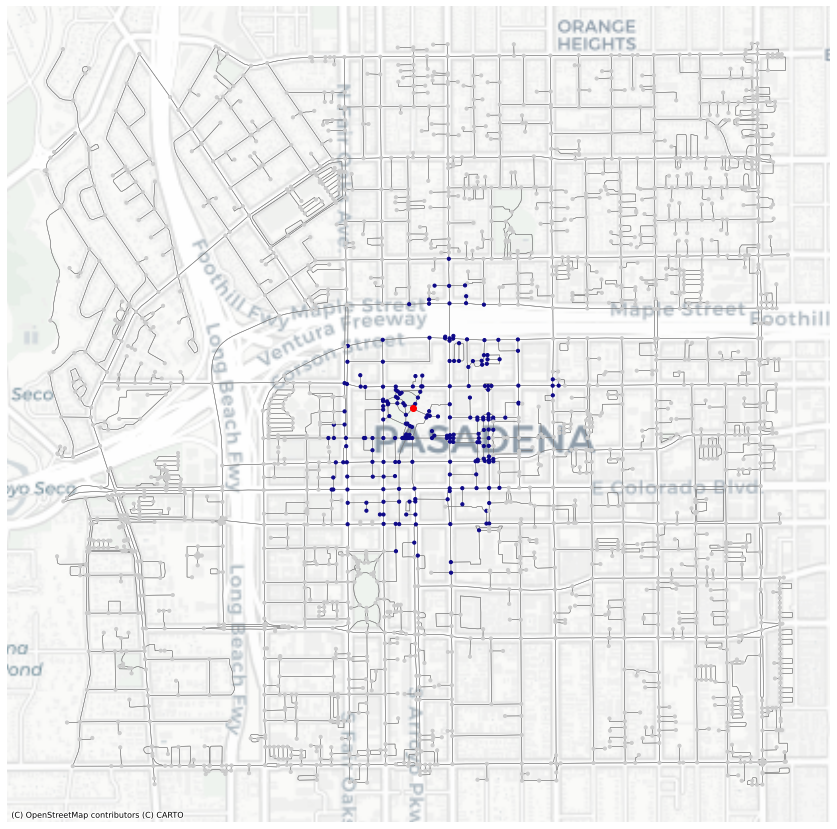

In [226]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [227]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
16218739,4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,POINT (-13152450.736 4048392.897),10 mins,#0d0887
601840322,4.048456e+06,-1.315245e+07,NaN,3,-118.150483,34.146247,POINT (-13152451.649 4048456.344),10 mins,#0d0887
122575436,4.048394e+06,-1.315228e+07,traffic_signals,4,-118.148901,34.145787,POINT (-13152275.453 4048394.443),10 mins,#0d0887
122615775,4.048328e+06,-1.315245e+07,NaN,3,-118.150464,34.145293,POINT (-13152449.467 4048328.011),10 mins,#0d0887
601842453,4.048393e+06,-1.315252e+07,NaN,3,-118.151096,34.145776,POINT (-13152519.799 4048393.004),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7249382732,4.049388e+06,-1.315203e+07,NaN,1,-118.146653,34.153177,POINT (-13152025.240 4049388.479),10 mins,#0d0887
8692603176,4.049390e+06,-1.315188e+07,NaN,1,-118.145317,34.153184,POINT (-13151876.539 4049389.528),10 mins,#0d0887
7882966091,4.048334e+06,-1.315215e+07,NaN,3,-118.147752,34.145336,POINT (-13152147.636 4048333.862),10 mins,#0d0887


In [228]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

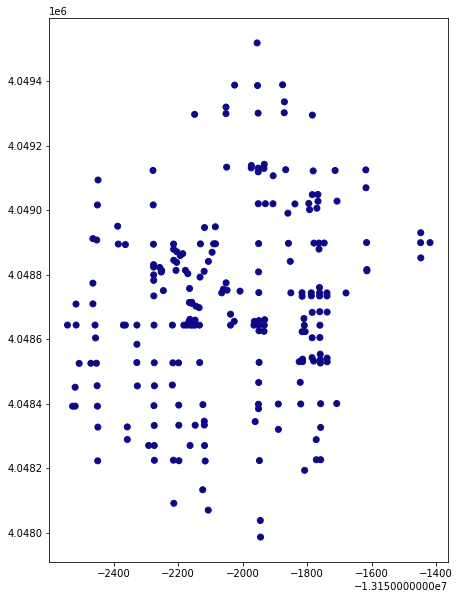

In [229]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

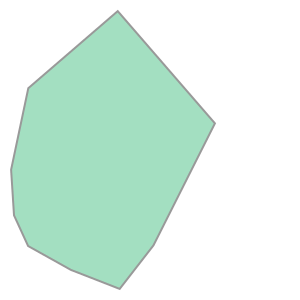

In [230]:
gdf_10.unary_union.convex_hull

In [231]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13152543.688 4048644.494, -131525...",4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,#0d0887


In [232]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13151944.923 4047986.976, -13152213..."


In [233]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13151944.923 4047986.976, -13152213..."


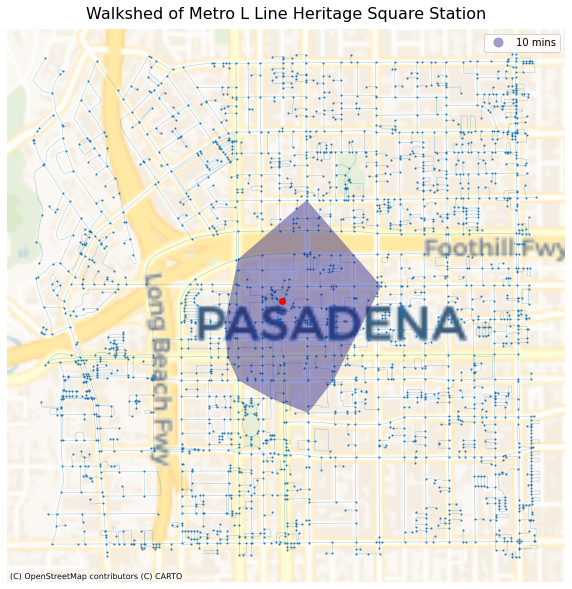

In [234]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

### Del Mar Station

In [14]:
# Let's start by orienting ourselves around the Del Mar Station by calling for it by address in osmnx

address = 'Del Mar, South Raymond Avenue, Old Pasadena, Pasadena, Los Angeles County, California, 91105, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [15]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.85 s, sys: 126 ms, total: 3.98 s
Wall time: 11.7 s


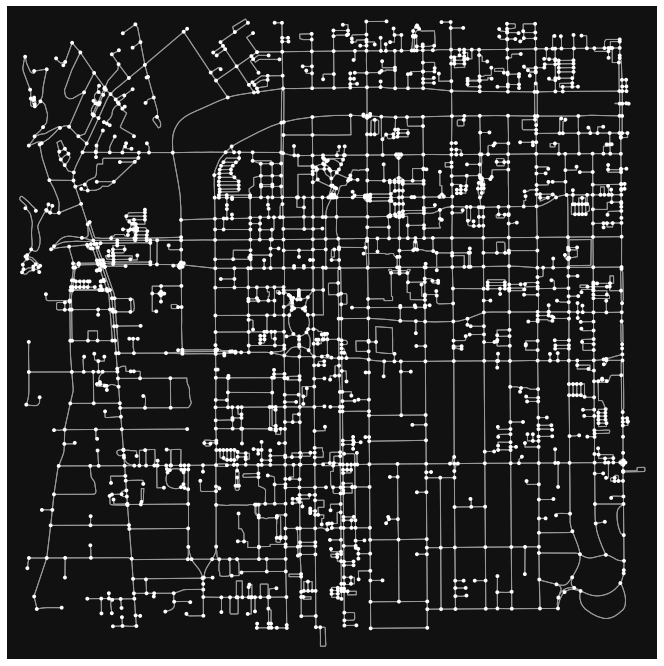

In [16]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [17]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [18]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [19]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14963716,4.049279e+06,-1.315043e+07,traffic_signals,4,-118.132316,34.152361,POINT (-13150429.308 4049278.739)
6784510760,4.049278e+06,-1.315040e+07,NaN,3,-118.132087,34.152358,POINT (-13150403.793 4049278.403)
3892769467,4.049279e+06,-1.315045e+07,traffic_signals,4,-118.132468,34.152362,POINT (-13150446.139 4049278.941)
1995207967,4.049204e+06,-1.315043e+07,NaN,4,-118.132311,34.151805,POINT (-13150428.729 4049204.015)
6784510757,4.049306e+06,-1.315043e+07,NaN,3,-118.132316,34.152564,POINT (-13150429.308 4049306.141)


<AxesSubplot:>

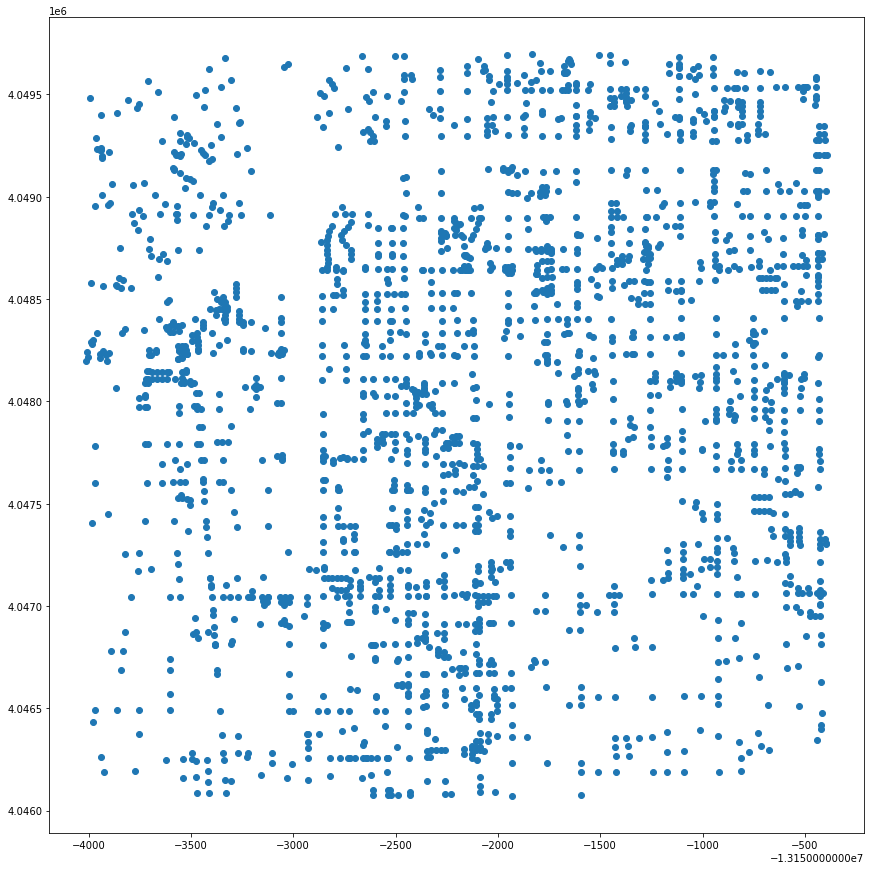

In [20]:
gdf_nodes.plot(figsize=(15,15))

In [21]:
gdf_edges.head()

osmid  oneway               name  \
u          v          key                                                      
14963716   6784510760 0                 405328940   False       Maple Street   
           3892769467 0                 607802969   False       Maple Street   
           1995207967 0    [173415946, 173415947]   False  North Lake Avenue   
           6784510757 0                 385937988   False  North Lake Avenue   
6784510760 14963716   0                 405328940   False       Maple Street   

                             highway  length  \
u          v          key                      
14963716   6784510760 0      primary  21.093   
           3892769467 0      primary  13.914   
           1995207967 0    secondary  61.772   
           6784510757 0    secondary  22.659   
6784510760 14963716   0      primary  21.093   

                                                                    geometry  \
u          v          key                                                      
14963716   6784510760 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           3892769467 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           1995207967 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           6784510757 0    LINESTRING (-13150429.308 4049278.739, -131504...   
6784510760 14963716   0    LINESTRING (-13150403.793 4049278.403, -131504...   

                          maxspeed bridge lanes access service  ref tunnel  \
u          v          key                                                    
14963716   6784510760 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           3892769467 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           1995207967 0     35 mph    yes   NaN    NaN     NaN  NaN    NaN   
           6784510757 0     35 mph    NaN   NaN    NaN     NaN  NaN    NaN   
6784510760 14963716   0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   

                          width  
u          v          key        
14963716   6784510760 0     NaN  
           3892769467 0     NaN  
           1995207967 0     NaN  
           6784510757 0     NaN  
6784510760 14963716   0     NaN

<AxesSubplot:>

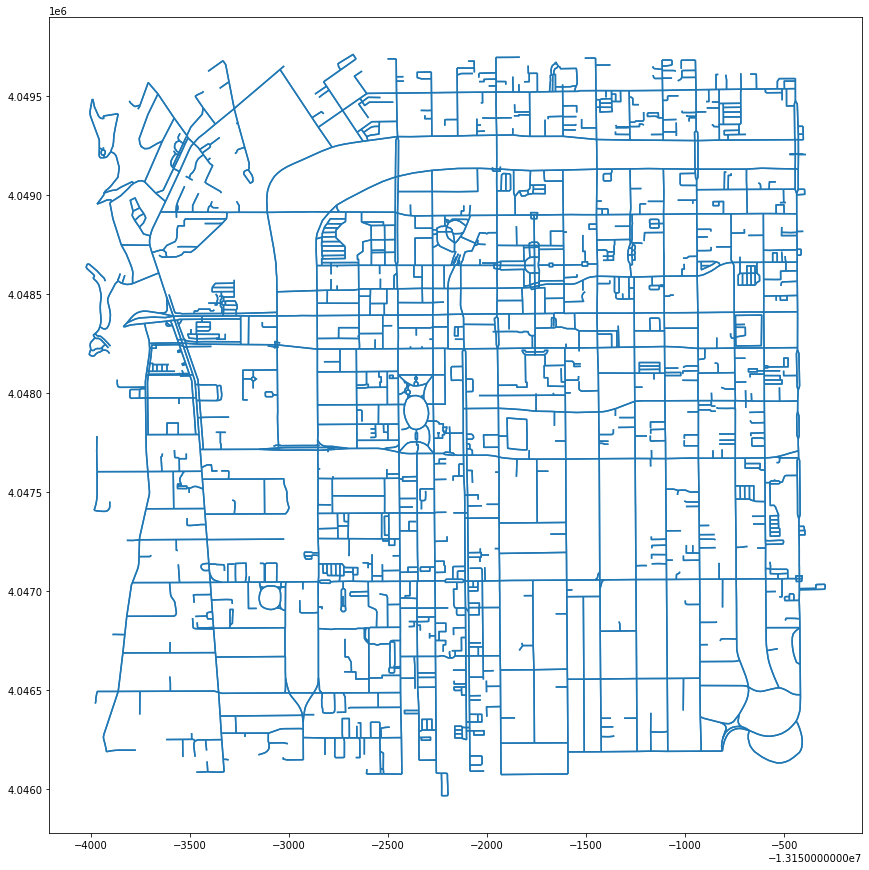

In [22]:
gdf_edges.plot(figsize=(15,15))

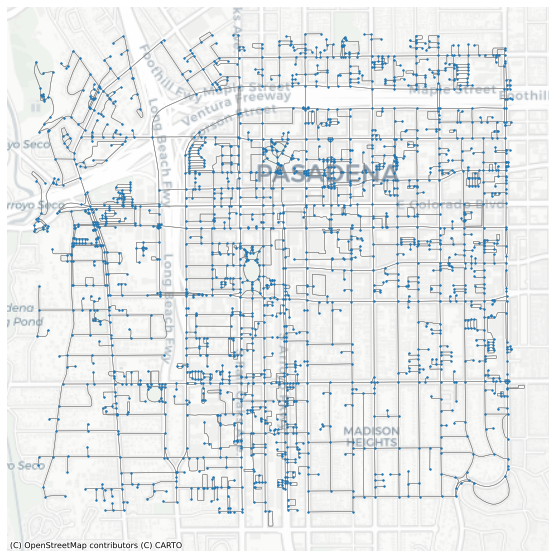

In [23]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [24]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13154010.901174664
4046072.998110596
-13150391.069632793
4049695.185661036


In [25]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13152200.985403728
4047884.0918858163


In [26]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 1995241213


In [27]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995241213,4.047831e+06,-1.315221e+07,NaN,1,-118.148271,34.141596,POINT (-13152205.321 4047830.780)


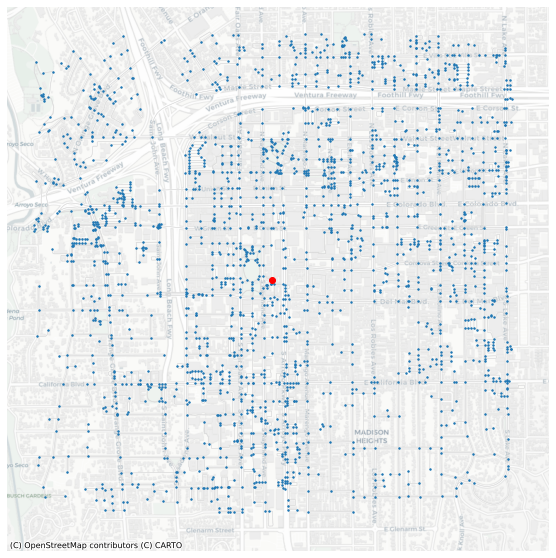

In [28]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [29]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width
u,v,key,,,,,,,,,,,,,,
6817163357,7153773770,0,129703009,False,South Raymond Avenue,tertiary,54.832,"LINESTRING (-13152257.686 4046146.438, -131522...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3823850483,123209307,0,"[844957289, 379038084, 13385287]",False,Markham Place,"[residential, footway]",290.322,"LINESTRING (-13153019.523 4046669.026, -131530...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6788123197,6788123197,1,723769494,False,NaN,service,120.316,"LINESTRING (-13152067.797 4046293.923, -131520...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5551739689,5551739718,0,405329010,False,South Arroyo Parkway,primary,77.672,"LINESTRING (-13152091.085 4046564.759, -131520...",35 mph,NaN,2,NaN,NaN,NaN,NaN,NaN
7458959730,7458959731,0,797530160,False,NaN,service,49.482,"LINESTRING (-13150710.991 4048543.868, -131507...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,NaN


In [30]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [31]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,,
5549289832,5549289856,0,166979334,False,Pasadena Avenue,secondary,34.760,"LINESTRING (-13152851.375 4047136.699, -131528...",NaN,NaN,NaN,NaN,NaN,CA 710,NaN,NaN,0.434500
6071486705,5551739712,0,579759710,False,NaN,service,19.072,"LINESTRING (-13152130.058 4046515.161, -131521...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,NaN,0.238400
7436844490,122758955,0,167078568,False,Edmondson Alley,service,75.102,"LINESTRING (-13152352.998 4047303.296, -131523...",NaN,NaN,NaN,NaN,alley,NaN,NaN,NaN,0.938775
4367182003,4367181999,0,439090765,False,NaN,footway,11.299,"LINESTRING (-13151758.618 4048289.905, -131517...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.141237
1446791941,1446791928,0,131467710,False,NaN,footway,7.111,"LINESTRING (-13153524.435 4048153.020, -131535...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.088887


In [32]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [33]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [34]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 1995241213, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 179 nodes within 10 minutes 


In [35]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
122596244,4.048644e+06,-1.315176e+07,NaN,3,-118.144278,34.147642,POINT (-13151760.834 4048643.970),NaN,NaN
122596134,4.048991e+06,-1.315186e+07,NaN,3,-118.145170,34.150224,POINT (-13151860.197 4048991.374),NaN,NaN
1810803449,4.049009e+06,-1.315394e+07,NaN,4,-118.163818,34.150352,POINT (-13153936.039 4049008.564),NaN,NaN
8822789797,4.048847e+06,-1.315246e+07,NaN,3,-118.150601,34.149149,POINT (-13152464.740 4048846.732),NaN,NaN
6078112233,4.049492e+06,-1.315140e+07,NaN,1,-118.141037,34.153947,POINT (-13151400.125 4049492.126),NaN,NaN
369836521,4.048758e+06,-1.315217e+07,NaN,4,-118.147909,34.148488,POINT (-13152165.046 4048757.873),NaN,NaN
122887392,4.048230e+06,-1.315135e+07,NaN,3,-118.140543,34.144565,POINT (-13151345.111 4048230.185),NaN,NaN
4080796868,4.047464e+06,-1.315072e+07,NaN,3,-118.134947,34.138869,POINT (-13150722.112 4047463.963),NaN,NaN
6734662346,4.046258e+06,-1.315277e+07,NaN,3,-118.153340,34.129901,POINT (-13152769.667 4046257.936),NaN,NaN


In [36]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [37]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
3178419027,4.048074e+06,-1.315248e+07,NaN,3,-118.150699,34.143402,POINT (-13152475.650 4048073.676),10 mins,#0d0887
7958581368,4.048214e+06,-1.315394e+07,NaN,3,-118.163883,34.144444,POINT (-13153943.341 4048213.910),NaN,#cccccc
3459717171,4.048810e+06,-1.315283e+07,NaN,3,-118.153894,34.148876,POINT (-13152831.315 4048809.983),NaN,#cccccc
6069893119,4.046300e+06,-1.315213e+07,NaN,3,-118.147561,34.130213,POINT (-13152126.385 4046299.894),NaN,#cccccc
8395785250,4.049393e+06,-1.315081e+07,NaN,3,-118.135715,34.153213,POINT (-13150807.594 4049393.362),NaN,#cccccc


<AxesSubplot:>

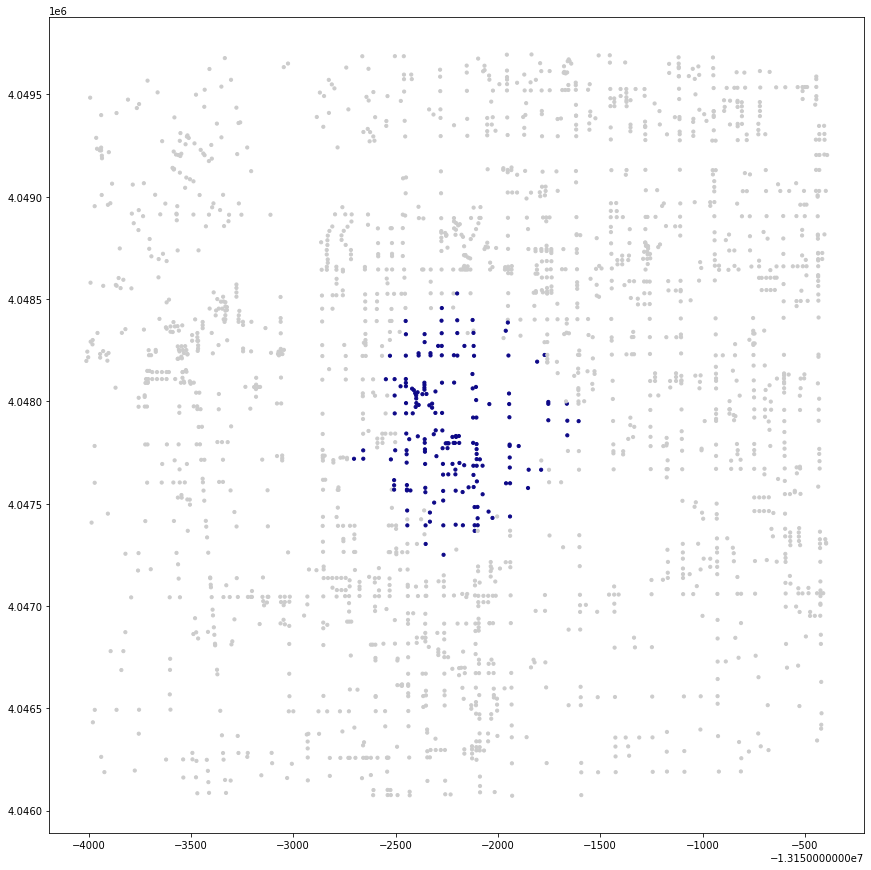

In [38]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

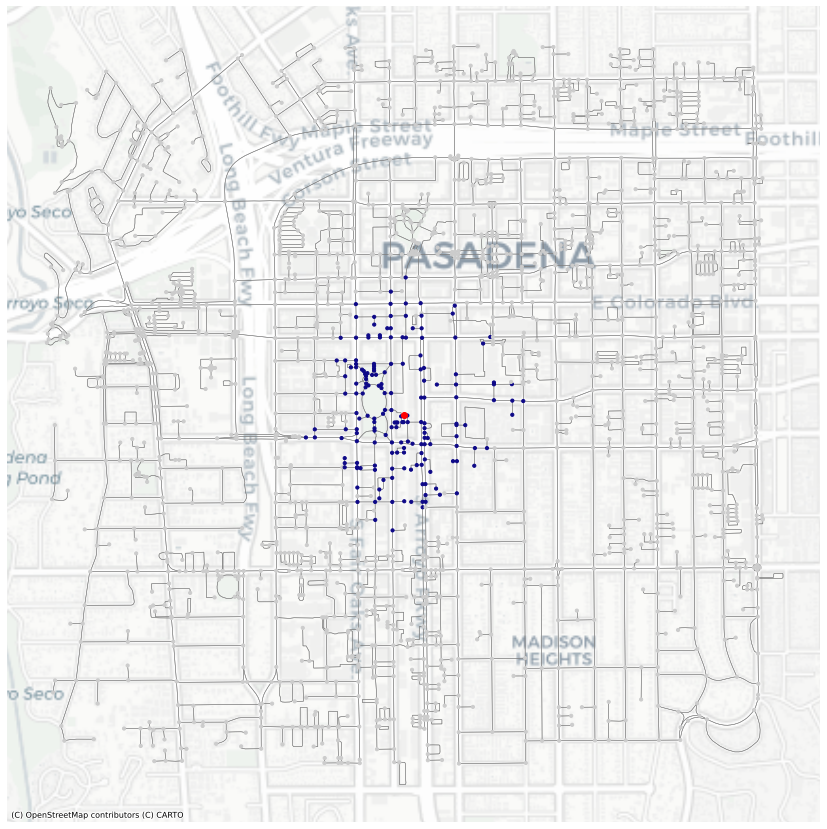

In [39]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[1995241213]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [40]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
16218739,4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,POINT (-13152450.736 4048392.897),10 mins,#0d0887
122575436,4.048394e+06,-1.315228e+07,traffic_signals,4,-118.148901,34.145787,POINT (-13152275.453 4048394.443),10 mins,#0d0887
122615775,4.048328e+06,-1.315245e+07,NaN,3,-118.150464,34.145293,POINT (-13152449.467 4048328.011),10 mins,#0d0887
29322322,4.047716e+06,-1.315252e+07,NaN,3,-118.151123,34.140746,POINT (-13152522.860 4047716.495),10 mins,#0d0887
725857496,4.047742e+06,-1.315245e+07,NaN,3,-118.150433,34.140933,POINT (-13152446.005 4047741.674),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8366502777,4.047717e+06,-1.315209e+07,NaN,3,-118.147218,34.140748,POINT (-13152088.124 4047716.737),10 mins,#0d0887
8366502785,4.047743e+06,-1.315210e+07,NaN,3,-118.147359,34.140944,POINT (-13152103.865 4047743.113),10 mins,#0d0887
8366502796,4.047767e+06,-1.315210e+07,NaN,3,-118.147361,34.141119,POINT (-13152104.009 4047766.677),10 mins,#0d0887


In [41]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

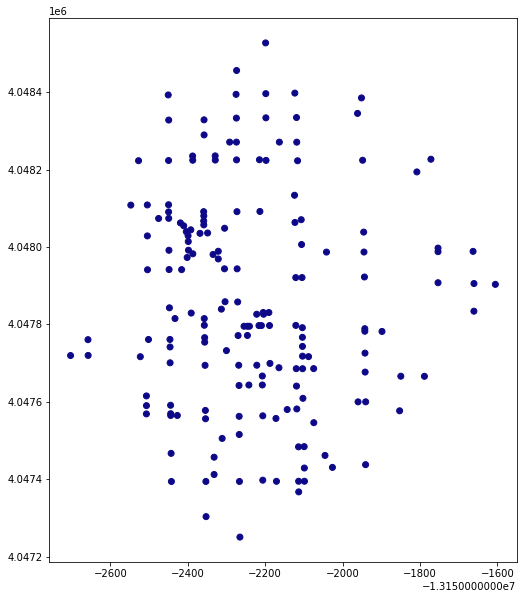

In [42]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

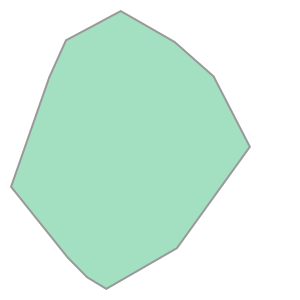

In [43]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [44]:
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13152703.098 4047719.535, -131526...",4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,#0d0887


In [45]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


In [46]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


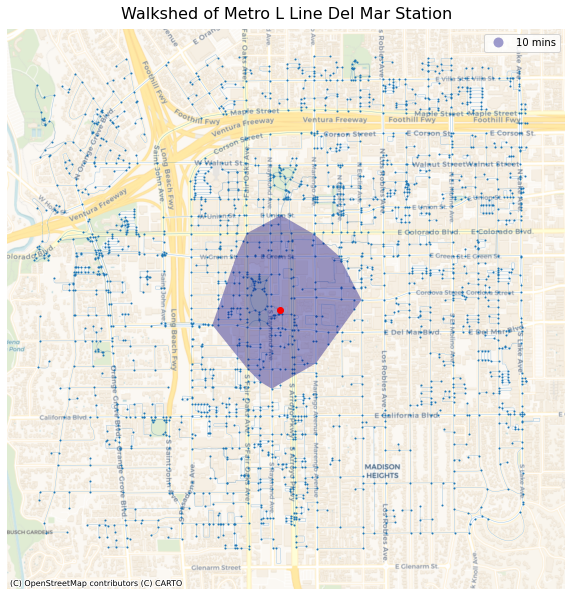

In [47]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Del Mar Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)